### Packages that needed to be Downloaded
1. ordered_list

In [1]:
#pip install ordered_set

In [2]:
#Abstract class

In [3]:
from abc import ABCMeta, abstractmethod
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go 

In [4]:
# Templete Class for the cell and patient sample
class EDA:
   
    __metaclass__ = ABCMeta
    
    @abstractmethod
    def __init__(self):
        pass
    
    @abstractmethod
    def transpose(self):
        pass
    
    @abstractmethod
    def to_lyst(self):
        pass
    
    @abstractmethod
    def unique_value_lists(self):
        pass
    
    @abstractmethod
    def array_to_df(self):
        pass
    
    @abstractmethod
    def add_column(self):
        pass
    
    @abstractmethod
    def grouping(self):
        pass
    
    @abstractmethod
    def grouping_by_number(self):
        pass
    
    @abstractmethod
    def catagorise(self):
        pass
    
    @abstractmethod
    def add_column_name(self):
        pass
    
    @abstractmethod
    def transopse(self):
        pass
    
    @abstractmethod
    def re_set_index(self):
        pass
    
    @abstractmethod
    def rename_column(self):
        pass
        
    @abstractmethod
    def pick_column(self):
        pass
    
    @abstractmethod
    def group_by_tissue(self):
        pass

    @abstractmethod
    def get_df(self):
        pass
    
    @abstractmethod
    def count_catagories(self):
        pass
    
    @abstractmethod
    def df_length(self):
        pass
    
    @abstractmethod
    def convert_binary(self):
        pass
    
    @abstractmethod
    def group_by_cancer_type(self):
        pass
    
    @abstractmethod
    def group_by_mutation_level(self):
        pass
    
    @abstractmethod
    def binary_df(self):
        pass
  

##### Functional classes for cell-line, patient tissue sample, annotation and chi-square test.

In [5]:
class CellLine(EDA):
         
    def __init__(self, data, sep, header=None):
        self.df = pd.read_csv(data, header=None, sep=sep).round(3).transpose()
        
    def get_df(self):
        return self.df  
    
    def to_lyst(self, col):
        df = self.df[col].to_list()
        return df
    
    def unique_value_lists(self):
        for column in self.df.columns:
            uniq_list = self.df[column].unique()
        return uniq_list
    
    def add_column(self, colname, value):
        self.df[colname] =value
        return self.df
    
    
    def transopse(self):
        return self.df.transpose()

    def grouping(self): 
        df1 = self.df.copy()
        df1 = np.where((df1 < 0.06), 1, df1)
        df2 = np.where(((df1 > 0.05) & (df1 <= 0.15)), 2, df1)
        df3 = np.where (((df2 > 0.15) & (df2 <= 0.65)), 3, df2)
        df4 = np.where (((df3 > 0.65) & (df3 < 1.0)), 4 , df3)
        
        df1 = df4.copy().astype(str)
        df1 = np.where(df1 == '1.0', 'No', df1)
        df2 = np.where(df1 == '2.0', 'Low', df1)
        df3 = np.where(df2 == '3.0', 'Medium', df2)
        df4 = np.where(df3 == '4.0', 'High', df3)
        self.df = pd.DataFrame(df4)
        
        return self.df
    
    
    def grouping_by_number(self):
        df1 = self.df.copy()
        df1 = np.where((df1 < 0.06), 1, df1)
        df2 = np.where(((df1 > 0.05) & (df1 <= 0.15)), 2, df1)
        df3 = np.where (((df2 > 0.15) & (df2 <= 0.65)), 3, df2)
        df4 = np.where (((df3 > 0.65) & (df3 < 1.0)), 4 , df3) 
        self.df = pd.DataFrame(df4)
        return self.df
    
    def rename_column(self, cols):
        self.df.columns = cols
        return self.df
    

    def count_categories(self, valuesToCount):
        value = self.df[self.df == valuesToCount].count()
        return value
    
    def df_length(self):
        length = len(self.df)
        return length
    
    def convert_binary(self):
        df1 = self.df.copy()
        df1 = np.where((df1 >= 0.05), 1, df1)
        df1 = np.where(((df1 > 0.00) & (df1 < 0.05)), 0, df1).astype('float32')
    
        return df1
    
    def group_by_tissue (self, column_name, row_name):
        df = self.df.loc[self.df[column_name]== row_name]   
        return df
    
    def group_by_cancer_type(self, lyst, col_name):
        self.grouped_cancer_types = []
        for i in lyst:
            i = CellLine.group_by_tissue(self, col_name, i)
            self.grouped_cancer_types.append(i) 
        return self.grouped_cancer_types
    
    def group_by_mutation_level(self, value):
        
        df = self.df[self.df == value]
        return df
    def pick_column(self, col):
        col = self.df[col]
        return col

In [6]:
class TissueSample(EDA):
    
    def __init__(self, data, sep, header=None):
        self.df = pd.read_csv(data, header=None, sep=sep).round(3).transpose()
        
    def get_df(self):
        return self.df
    
    def to_lyst(self, col):
        df_list = self.df[col].to_list()
        return df_list
    
    def unique_value_lists(self, unique_value):
        value_list = self.df[unique_value].unique().tolist()
        return value_list
    
    def add_column(self, colname, value):
        self.df[colname] =value
        return self.df
    
    def transopse(self):
        return self.df.transpose()
    
    def grouping(self):
        df1 = self.df.copy()
        df1 = np.where((df1 < 0.06), 1, df1)
        df2 = np.where(((df1 > 0.05) & (df1 <= 0.15)), 2, df1)
        df3 = np.where (((df2 > 0.15) & (df2 <= 0.65)), 3, df2)
        df4 = np.where (((df3 > 0.65) & (df3 < 1.0)), 4 , df3)
        
        df11 = df4.copy().astype(str)
        df11 = np.where(df11 == '1.0', 'No', df11)
        df22 = np.where(df11 == '2.0', 'Low', df11)
        df33 = np.where(df22 == '3.0', 'Medium', df22)
        df44 = np.where(df33 == '4.0', 'High', df33)
        self.df = pd.DataFrame(df44)
        
        return self.df
    
    def grouping_by_number(self):
        df1 = self.df.copy()
        df1 = np.where((df1 < 0.06), 1, df1)
        df2 = np.where(((df1 > 0.05) & (df1 <= 0.15)), 2, df1)
        df3 = np.where (((df2 > 0.15) & (df2 <= 0.65)), 3, df2)
        df4 = np.where (((df3 > 0.65) & (df3 < 1.0)), 4 , df3) 
        self.df = pd.DataFrame(df4)
        return self.df
    
    def count_categories(self, valuesToCount):
        value = self.df[self.df == valuesToCount].count()
        return value
    
    def convert_binary(self):
        df1 = self.df.copy()
        df2 = np.where((df1 >= 0.05), 1, df1)
        self.df = np.where(((df2 > 0.00) & (df2 < 0.05)), 0, df2).astype('float32')
        
        return self.df
    
     
    
    def df_length(self):
        length = len(self.df)
        return length
    
    def rename_column(self, cols):
        self.df.columns = cols # type: ignore
        return self.df
    
    def group_by_tissue (self, column_name, row_name):
        df = self.df[self.df[column_name]== row_name]   
        return df
    
    def group_by_cancer_type(self, lyst, col_name):
        grouped_cancer_types = []
        for i in lyst:
            i = TissueSample.group_by_tissue(self, col_name, i)
            grouped_cancer_types.append(i)
        return grouped_cancer_types
    
    def group_by_mutation_level(self, value):
        
        df = self.df[self.df == value]
        return df

In [7]:
class Annotation(EDA):
    def __init__(self, data, sep, header):
        self.df = pd.read_csv(data, header=header, sep=sep).round(3)
        
    def get_df(self):
        return self.df
    
    def to_lyst(self, df_col):
        new_lyst = self.df[df_col].to_list()
        return new_lyst
    
    def pick_column(self, col):
        col = self.df[col]
        return col

In [8]:
class ChiSquareIndependence(CellLine):
    def __init__(self, no, low, med, high):
        self.no = no
        self.low = low
        self.med = med
        self.high = high
        self.df =  pd.DataFrame([self.no, self.low, self.med, self.high]).transpose()
        
        
    def get_mutation_level(self):
        return {'no':self.no, 'low': self.low, 'medium': self.med, 'high': self.high}
    
    def observed_values_df(self):
        df = pd.DataFrame(self.df.iloc[:,:-1].sum(axis=0))
        return df 
    
    def df_concat(self):
        df = pd.concat([self], axis=1)  


#### Dataframe objects

In [9]:
#load mutation annotation
mut_anno = Annotation('MutationAnnotation.tsv', '\t', header=0)

#load cell line annotation
cell_anno = Annotation('CellLineAnnotation.tsv', '\t', header=0)

#Load the patient tissue sample annotation
tissue_anno = Annotation('PatientAnnotation.tsv', '\t', header=0)


#save the mutation list and the cancer types for both samples in a list
mut_level = ['No', 'Low', 'Medium','High']
mutation_list = mut_anno.to_lyst('symbol')
cell_cancer_type = cell_anno.to_lyst('tissue')
tissue_cancer_type = tissue_anno.to_lyst('tissue')


#### Proportional mutation analysis
The samples are grouped in two ways:

1. four levels (no, low, medium, and high mutations), this is used to perform proportional analysis, statistical tests, and plotting .

2. in two levels, mutated or not mutated (this is used for plotting graphs to show the mutation profiles in general; it is done by adding the low, medium, and high mutations to represent samples that are mutated over 5%).

Tasks to perform:

1. Grouping of the mutation types for cell line and patient tissue dataset
2. Count the wild and mutated samples
3. perform proportional analysis on the level of mutations
4. perform proportional analysis based on cancer types for both samples


##### 1. Count

In [10]:
#Catagorise mutational level and count
#cell line(four levels)

#load cell_line data
cell = CellLine('CellLine_Mutations.tsv','\t')

cell_group = cell.grouping()

#count mutation frequencies 
cell_no= cell.count_categories('No')
cell_low = cell.count_categories('Low')
cell_medium = cell.count_categories('Medium')
cell_high = cell.count_categories('High')

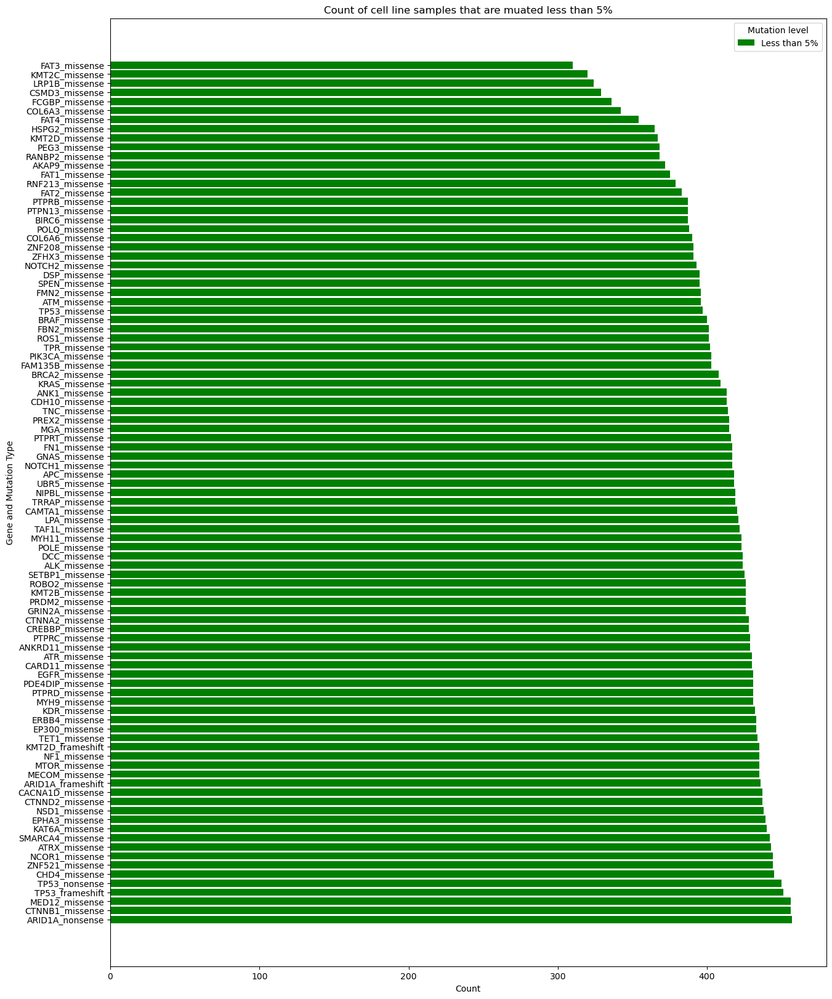

In [11]:
#plot the count of the catagories 
#cellline (no mutation - less than 5 %)
cell_count_no_df = pd.DataFrame([mutation_list, cell_no]).transpose()
cell_count_no_df.columns = ['Gene and Mutation type', 'Less than 5%']


#bar graph
plt.figure(figsize=(15, 20))
wild_mutation_cell = cell_count_no_df.sort_values(by= 'Less than 5%', ascending=False) #sort values
plt.barh(wild_mutation_cell['Gene and Mutation type'], wild_mutation_cell['Less than 5%'], color='green', label = 'Less than 5%' )

plt.xlabel('Count')
plt.ylabel('Gene and Mutation Type')
plt.title('Count of cell line samples that are muated less than 5%')
plt.legend(title='Mutation level',)
#plt.savefig('final_plots/cell_line_wild_mutation.png')
plt.show()

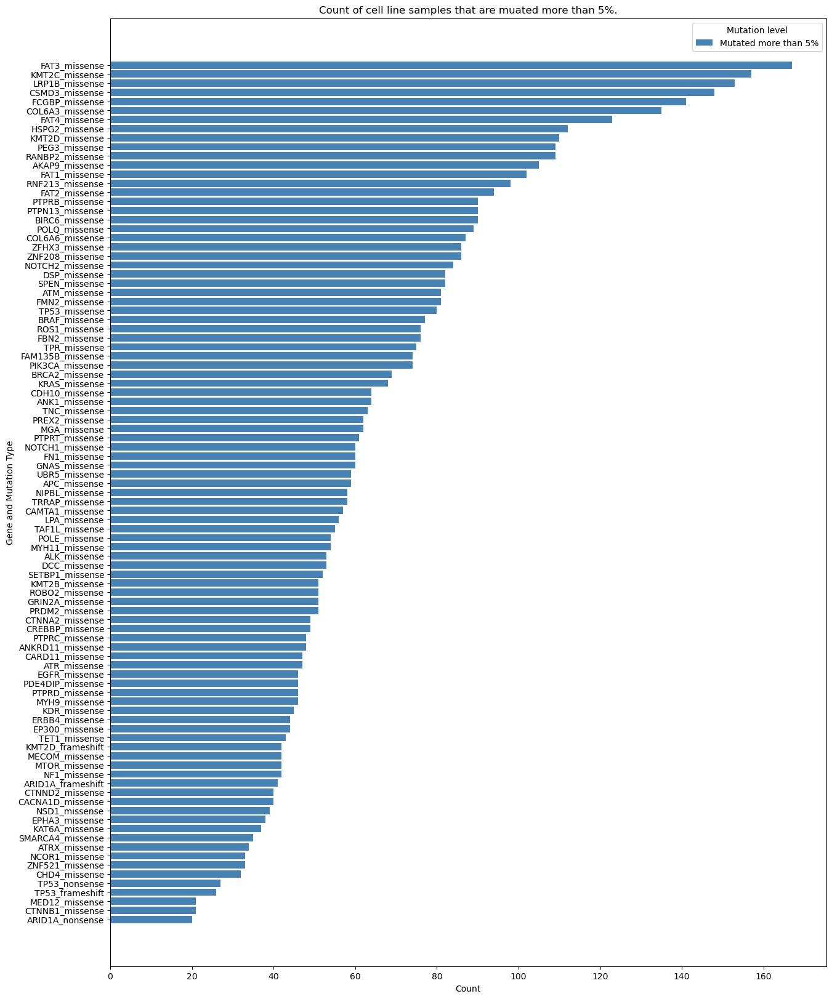

In [12]:
# bar plot for mutated cell lines over 5%
cell_mutated_count =  cell_low + cell_medium + cell_high

cell_mutated_count= pd.DataFrame([mutation_list, cell_mutated_count]).transpose()
cell_mutated_count.columns = ['Gene and Mutation Type','Mutated more than 5%']



plt.figure(figsize=(15, 20))
cell_mutated_bar = cell_mutated_count.sort_values(by= 'Mutated more than 5%', ascending=True) #sort values
plt.barh(cell_mutated_bar['Gene and Mutation Type'], cell_mutated_bar['Mutated more than 5%'], color='steelblue', label = 'Mutated more than 5%' )

plt.xlabel('Count')
plt.ylabel('Gene and Mutation Type')
plt.title('Count of cell line samples that are muated more than 5%.')
plt.legend(title='Mutation level',)
#plt.savefig('final_plots/cell_line_mutated_over_5percent')
plt.show()

In [13]:
#Catagorise mutational level and count
#patient tissue sample(four levels)

#load patient tissue sample data 
tissue = TissueSample('Patient_Mutations.tsv','\t')

tissue_group =tissue.grouping()

#count mutation frequencies

tissue_no= tissue.count_categories('No')
tissue_low = tissue.count_categories('Low')
tissue_medium = tissue.count_categories('Medium')
tissue_high = tissue.count_categories('High')

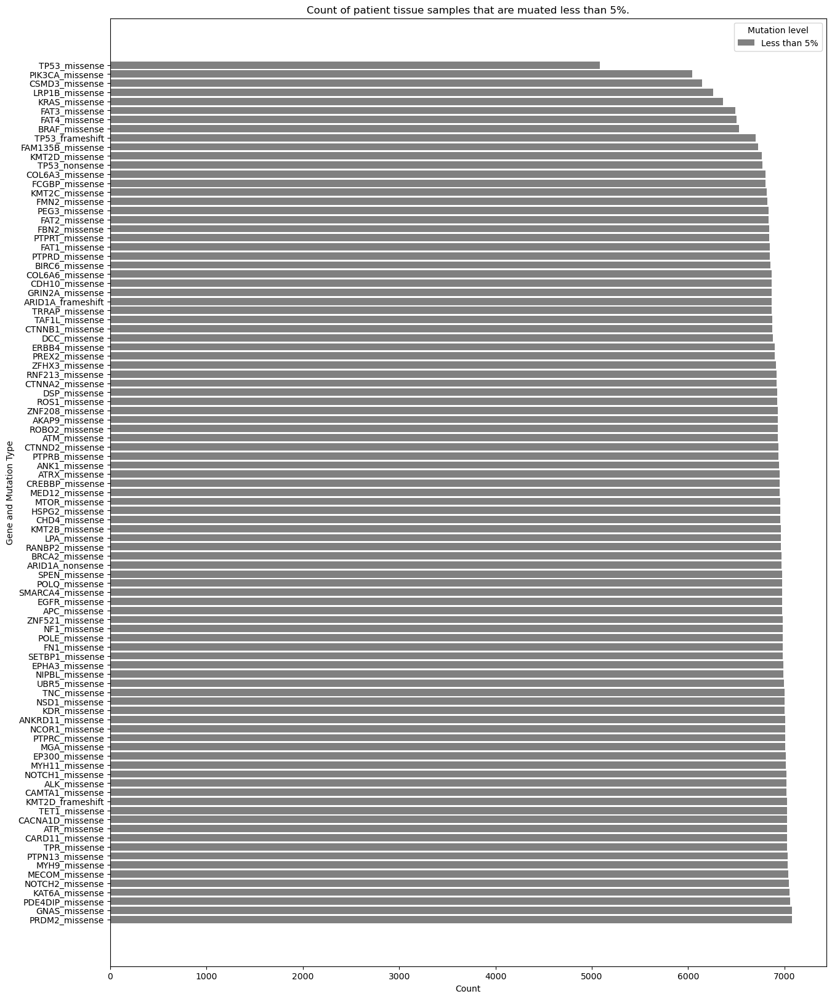

In [14]:
#plot the count of the catagories 
#patient tissue sample (no mutation - less than 5 %)
tissue_count_df = pd.DataFrame([mutation_list, tissue_no]).transpose()
tissue_count_df.columns = ['Gene and Mutation type', 'Less than 5%']


#bar graph
plt.figure(figsize=(15, 20))
wild_mutation_tissue = tissue_count_df.sort_values(by= 'Less than 5%', ascending=False) #sort values
plt.barh(wild_mutation_tissue['Gene and Mutation type'], wild_mutation_tissue['Less than 5%'], color='gray', label = 'Less than 5%' )

plt.xlabel('Count')
plt.ylabel('Gene and Mutation Type')
plt.title('Count of patient tissue samples that are muated less than 5%.')
plt.legend(title='Mutation level',)
#plt.savefig('final_plots/patient_tissue_sample_wild_mutation.png')
plt.show()

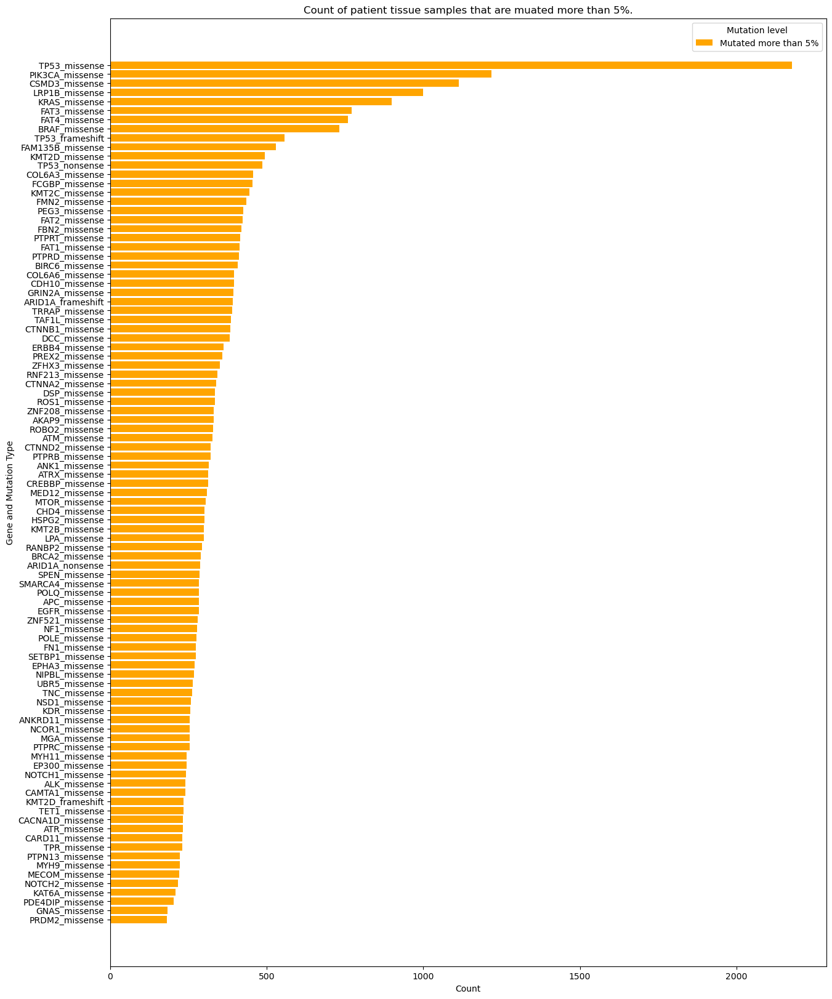

In [15]:
# bar plot for mutated cell lines over 5%
tissue_mutated_count =  tissue_low + tissue_medium + tissue_high

tissue_mutated_count= pd.DataFrame([mutation_list, tissue_mutated_count]).transpose()
tissue_mutated_count.columns = ['Gene and Mutation Type','Mutated more than 5%']



plt.figure(figsize=(15, 20))
tissue_mutated_bar = tissue_mutated_count.sort_values(by= 'Mutated more than 5%', ascending=True) #sort values
plt.barh(tissue_mutated_bar['Gene and Mutation Type'], tissue_mutated_bar['Mutated more than 5%'], color='orange', label = 'Mutated more than 5%' )

plt.xlabel('Count')
plt.ylabel('Gene and Mutation Type')
plt.title('Count of patient tissue samples that are muated more than 5%.')
plt.legend(title='Mutation level',)
#plt.savefig('final_plots/patient_tissue_sample_mutated_over_5percent')
plt.show()

##### 2. Proportion

In [16]:
# cell line genes proportion mutation
cell_length = cell.df_length() #cell line

cell_prop_no = round(cell_no/cell_length*100,2)
cell_prop_low = round(cell_low/cell_length*100, 2)
cell_prop_medium = round(cell_medium/cell_length*100, 2)
cell_prop_high = round(cell_high/cell_length*100,2)

In [17]:
# patient tissue sample proportional mutation 
tissue_length = tissue.df_length() #tissue sample

tissue_prop_no = round(tissue_no/tissue_length*100,2)
tissue_prop_low = round(tissue_low/tissue_length*100, 2)
tissue_prop_medium = round(tissue_medium/tissue_length*100, 2)
tissue_prop_high = round(tissue_high/tissue_length*100,2)

In [18]:
# aggregate the low, medium, high into cell line that have mutated #used for the dashboard
aggregated_cell = cell_prop_low + cell_prop_medium + cell_prop_high
aggregated_tissue = tissue_prop_low + tissue_prop_medium + tissue_prop_high
aggregated_df = pd.DataFrame([mutation_list, aggregated_cell, aggregated_tissue]).transpose()
aggregated_df.columns = ['Gene and Mutation Type', 'Proportion of Cell Line Samples with Mutation >5%', 'Proportion of Patient Tissue Samples with Mutation >5%']
aggregated_df

,Gene and Mutation Type,Proportion of Cell Line Samples with Mutation >5%,Proportion of Patient Tissue Samples with Mutation >5%
0,AKAP9_missense,22.02,4.54
1,ALK_missense,11.11,3.31
2,ANK1_missense,13.42,4.34
3,ANKRD11_missense,10.07,3.5
4,APC_missense,12.38,3.9
...,...,...,...
90,TRRAP_missense,12.16,5.37
91,UBR5_missense,12.37,3.63
92,ZFHX3_missense,18.04,4.83
93,ZNF208_missense,18.03,4.54


##### Graph the first 20 most mutated genes

In [19]:
top_20_agg_cell = aggregated_df.sort_values(by='Proportion of Cell Line Samples with Mutation >5%', ascending=False).head(20)
top_20_agg_cell = top_20_agg_cell.sort_values(by='Proportion of Cell Line Samples with Mutation >5%', ascending=False)


top_20_agg_tissue = aggregated_df.sort_values(by='Proportion of Patient Tissue Samples with Mutation >5%', ascending=False).head(20)
top_20_agg_tissue = top_20_agg_tissue.sort_values(by='Proportion of Patient Tissue Samples with Mutation >5%', ascending=False)




In [20]:
top_20_agg_cell

,Gene and Mutation Type,Proportion of Cell Line Samples with Mutation >5%,Proportion of Patient Tissue Samples with Mutation >5%
34,FAT3_missense,35.02,10.64
46,KMT2C_missense,32.92,6.13
51,LRP1B_missense,32.08,13.76
21,CSMD3_missense,31.03,15.33
37,FCGBP_missense,29.55,6.25
18,COL6A3_missense,28.3,6.3
35,FAT4_missense,25.78,10.45
42,HSPG2_missense,23.48,4.13
48,KMT2D_missense,23.06,6.8
76,RANBP2_missense,22.86,4.05


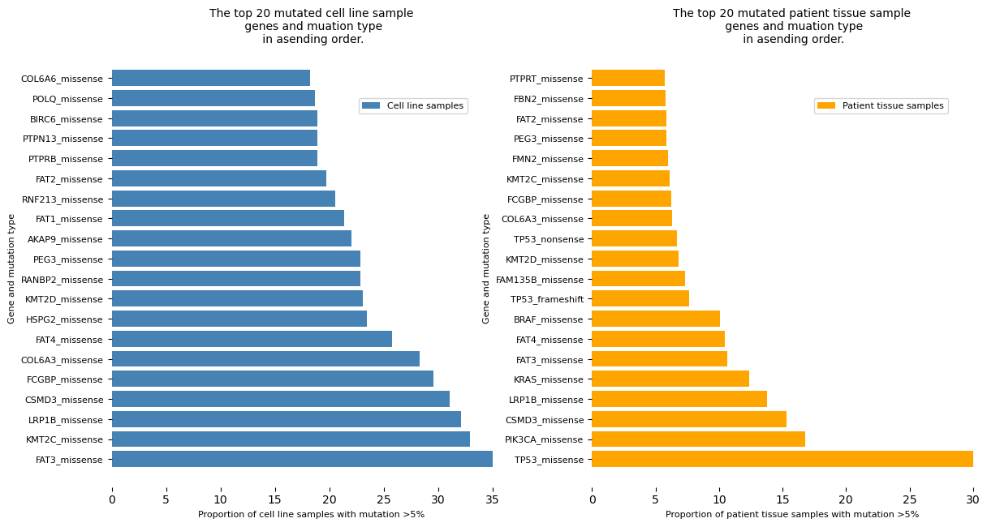

In [21]:
#plot the top 20 cell lines that are mutated

#bar plot 
fig, axs = plt.subplots(1,2,figsize=(14,7))

#subplot 1 data
x1= top_20_agg_cell['Gene and Mutation Type']
y1= top_20_agg_cell['Proportion of Cell Line Samples with Mutation >5%']

#subplot 2 data
x2=top_20_agg_tissue['Gene and Mutation Type']
y2 = top_20_agg_tissue['Proportion of Patient Tissue Samples with Mutation >5%']


#subplot 1
axs[0].barh(x1,y1, label='Cell line samples', color='steelblue')
axs[0].set_title('The top 20 mutated cell line sample\n genes and muation type\n in asending order.', fontsize=10)
axs[0].set_xlabel('Proportion of cell line samples with mutation >5%',fontsize=(8))
axs[0].set_ylabel('Gene and mutation type', fontsize=(8))
axs[0].legend(loc='upper right', bbox_to_anchor=(0.90,0.90),fontsize=8)



#subplot 2
axs[1].barh(x2,y2, label='Patient tissue samples', color='orange')
axs[1].set_title('The top 20 mutated patient tissue sample\n genes and muation type\n in asending order.', fontsize=10)
axs[1].set_xlabel('Proportion of patient tissue samples with mutation >5%',fontsize=(8) )
axs[1].set_ylabel('Gene and mutation type', fontsize=(8))
axs[1].legend(loc='upper right', bbox_to_anchor=(0.90,0.90),fontsize=8)

for ax in axs:
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    
for ax in axs:
    ax.tick_params(axis='y', labelsize=8)
#plt.savefig('final_plots/top_20_mutated')
plt.show()

The following two datasets combine the mutation levels for cell line and patient samples into individual data frames that will be used for the dashboard.

In [22]:
#cell line
cell_pro_df = pd.DataFrame([cell_prop_no,cell_prop_low,cell_prop_medium,cell_prop_high])
cell_pro_df.columns = mutation_list
cell_pro_df.index= mut_level
cell_pro_df

,AKAP9_missense,ALK_missense,ANK1_missense,ANKRD11_missense,APC_missense,ARID1A_frameshift,ARID1A_nonsense,ATM_missense,ATRX_missense,ATR_missense,...,TNC_missense,TP53_frameshift,TP53_missense,TP53_nonsense,TPR_missense,TRRAP_missense,UBR5_missense,ZFHX3_missense,ZNF208_missense,ZNF521_missense
No,77.99,88.89,86.58,89.94,87.63,91.40,95.81,83.02,92.87,90.15,...,86.79,94.55,83.23,94.34,84.28,87.84,87.63,81.97,81.97,93.08
Low,0.84,0.63,0.21,0.42,1.26,1.47,0.00,0.21,0.63,0.84,...,0.21,0.42,0.21,0.00,0.63,0.84,1.26,0.63,1.89,0.63
Medium,19.08,9.43,11.32,8.81,8.39,6.29,3.14,14.68,5.03,8.60,...,10.48,2.52,7.97,2.94,12.79,9.85,9.64,14.68,12.37,6.08
High,2.10,1.05,1.89,0.84,2.73,0.84,1.05,2.10,1.47,0.42,...,2.52,2.52,8.60,2.73,2.31,1.47,1.47,2.73,3.77,0.21


In [23]:
# tissue sample

tissue_pro_df = pd.DataFrame([tissue_prop_no, tissue_prop_low, tissue_prop_medium, tissue_prop_high])
tissue_pro_df.columns = mutation_list
tissue_pro_df.index = mut_level
tissue_pro_df

,AKAP9_missense,ALK_missense,ANK1_missense,ANKRD11_missense,APC_missense,ARID1A_frameshift,ARID1A_nonsense,ATM_missense,ATRX_missense,ATR_missense,...,TNC_missense,TP53_frameshift,TP53_missense,TP53_nonsense,TPR_missense,TRRAP_missense,UBR5_missense,ZFHX3_missense,ZNF208_missense,ZNF521_missense
No,95.45,96.69,95.66,96.50,96.10,94.61,96.03,95.51,95.70,96.80,...,96.40,92.34,70.00,93.32,96.83,94.63,96.36,95.18,95.45,96.16
Low,0.88,0.54,0.73,0.52,0.68,0.54,0.48,0.62,0.59,0.61,...,0.45,0.47,1.63,0.50,0.72,0.91,0.84,0.80,0.81,0.65
Medium,3.62,2.71,3.50,2.81,3.10,4.70,3.32,3.71,3.14,2.56,...,2.96,6.17,19.23,4.50,2.44,4.34,2.64,3.86,3.65,3.11
High,0.04,0.06,0.11,0.17,0.12,0.15,0.17,0.17,0.56,0.03,...,0.18,1.02,9.15,1.68,0.01,0.12,0.15,0.17,0.08,0.08


Next, the proportions of the cell lines and patient tissue samples will be calculated based on the cancer type and gene mutation type. 

In [24]:
from ordered_set import OrderedSet

In [25]:
#unique cancer types
cell_cancer_uniq = list(OrderedSet(cell_cancer_type))
tissue_cancer_uniq = list(OrderedSet(tissue_cancer_type))

In [26]:
#cell object
cell_type = CellLine('CellLine_Mutations.tsv','\t')
cell_type.grouping()
cell_type.rename_column(mutation_list)
cell_type.add_column('cancer_type', cell_cancer_type).head(5)

,AKAP9_missense,ALK_missense,ANK1_missense,ANKRD11_missense,APC_missense,ARID1A_frameshift,ARID1A_nonsense,ATM_missense,ATRX_missense,ATR_missense,...,TP53_frameshift,TP53_missense,TP53_nonsense,TPR_missense,TRRAP_missense,UBR5_missense,ZFHX3_missense,ZNF208_missense,ZNF521_missense,cancer_type
0,No,No,No,No,No,No,No,No,Medium,No,...,No,No,No,No,Medium,No,No,No,No,Esophagus
1,No,No,Medium,No,No,No,No,No,No,Medium,...,No,No,No,No,No,No,Medium,No,No,Thyroid
2,No,Medium,No,No,No,No,No,No,No,No,...,No,No,No,No,No,No,No,No,No,Liver
3,No,No,No,No,No,No,Medium,No,No,No,...,No,No,No,No,No,No,Medium,Low,No,Ovary
4,No,No,No,No,High,No,No,No,No,No,...,No,No,No,No,No,No,No,No,No,Skin


In [27]:
#tissue object
tissue_type = TissueSample('Patient_Mutations.tsv','\t')
tissue_type.grouping()
tissue_type.rename_column(mutation_list)
tissue_type.add_column('cancer_type', tissue_cancer_type).head(5)

,AKAP9_missense,ALK_missense,ANK1_missense,ANKRD11_missense,APC_missense,ARID1A_frameshift,ARID1A_nonsense,ATM_missense,ATRX_missense,ATR_missense,...,TP53_frameshift,TP53_missense,TP53_nonsense,TPR_missense,TRRAP_missense,UBR5_missense,ZFHX3_missense,ZNF208_missense,ZNF521_missense,cancer_type
0,No,No,No,No,No,No,No,No,No,No,...,No,No,No,No,Medium,No,No,No,No,Stomach
1,No,No,No,No,No,No,No,No,No,No,...,No,High,No,No,No,No,No,No,No,Ovary
2,No,No,No,No,No,No,No,No,No,No,...,No,No,No,No,No,No,No,No,No,Skin
3,No,No,No,No,No,No,No,No,No,No,...,No,Medium,No,No,No,No,No,No,No,Pancreas
4,No,No,No,No,No,No,No,No,No,No,...,No,Medium,No,No,No,No,No,No,No,Ovary


The two datasets are then grouped by their cancer type and saved in a list 

In [28]:
#cell line sample
cell_type_grouped = cell_type.group_by_cancer_type(cell_cancer_uniq,'cancer_type')

In [29]:
#patient tissue sample
tissue_type_grouped = tissue_type.group_by_cancer_type(tissue_cancer_uniq, 'cancer_type')

A dataframe is created for each cancer type, and the data sets are collected in a list in order. The count data frames will be used for the chi-square independence test, while the proportion datagrams will be used in the dashboard to compare the two samples' percentage changes. 

In [30]:
# df for each cell line cancer type

esophagus_cell = cell_type_grouped[0]
thyroid_cell = cell_type_grouped[1]
liver_cell = cell_type_grouped[2]
ovary_cell = cell_type_grouped[3] #compare it with tissue sample
skin_cell = cell_type_grouped[4]
c_nervous_s_cell = cell_type_grouped[5]
kidney_cell = cell_type_grouped[6]
breast_cell = cell_type_grouped[7]
lung_cell = cell_type_grouped[8]
intestine_cell = cell_type_grouped[9]
pancreas_cell = cell_type_grouped[10]
endometrium_cell = cell_type_grouped[11]
cervix_cell = cell_type_grouped[12]
stomach_cell = cell_type_grouped[13]
bladder_cell = cell_type_grouped[14]

#ordered list
cell_df_list = [esophagus_cell, thyroid_cell, liver_cell, ovary_cell, skin_cell,
                c_nervous_s_cell, kidney_cell, breast_cell, lung_cell, intestine_cell, 
                pancreas_cell, endometrium_cell, cervix_cell, stomach_cell, bladder_cell]

In [31]:
ovary_cell.shape

(34, 96)

In [32]:
# df for each tissue cancer type

stomach_tissue = tissue_type_grouped[0]
ovary_tissue = tissue_type_grouped[1] #compare it with cell line proportion
skin_tissue = tissue_type_grouped[2]
pancreas_tissue = tissue_type_grouped[3]
kidney_tissue = tissue_type_grouped[4] #compare it with cell line proportion
intestine_tissue = tissue_type_grouped[5]
c_nervous_s_tissue = tissue_type_grouped[6]
bladder_tissue = tissue_type_grouped[7]
lung_tissue = tissue_type_grouped[8]
cervix_tissue = tissue_type_grouped[9]
endometrium_tissue = tissue_type_grouped[10]
breast_tissue = tissue_type_grouped[11]
esophagus_tissue = tissue_type_grouped[12]
liver_tissue = tissue_type_grouped[13]
thyroid_tissue = tissue_type_grouped[14]

tissue_df_list = [esophagus_tissue, thyroid_tissue, liver_tissue, ovary_tissue, 
                  skin_tissue, c_nervous_s_tissue, kidney_tissue, breast_tissue, 
                  lung_tissue, intestine_tissue, pancreas_tissue, endometrium_tissue, 
                  cervix_tissue, stomach_tissue, bladder_tissue]

In [33]:
def each_cancer_types(df): # proportion for each cancer type

    df = df.drop('cancer_type', axis=1)
    no = round(df[df == 'No'].count()/len(df)*100,2)
    low = round(df[df == 'Low'].count()/len(df)*100,2)
    med = round(df[df == 'Medium'].count()/len(df)*100,2)
    high = round(df[df == 'High'].count()/len(df)*100,2)
    df=pd.DataFrame([no,low, med, high ])

    df.index = ['<5%', '5-15%', '16-65%', 'Above 65%'] # type: ignore

    return df  

In [34]:
#proportion cell line 

esophagus_cell_prop = each_cancer_types(esophagus_cell)

thyroid_cell_prop = each_cancer_types(thyroid_cell)

liver_cell_prop = each_cancer_types(liver_cell)

ovary_cell_prop = each_cancer_types(ovary_cell) 

skin_cell_prop = each_cancer_types(skin_cell)

c_nervous_s_cell_prop = each_cancer_types(c_nervous_s_cell)

kidney_cell_prop = each_cancer_types(kidney_cell)

breast_cell_prop = each_cancer_types(breast_cell)

lung_cell_prop = each_cancer_types(lung_cell)

intestine_cell_prop = each_cancer_types(intestine_cell)

pancreas_cell_prop = each_cancer_types(pancreas_cell)

endometrium_cell_prop = each_cancer_types(endometrium_cell)

cervix_cell_prop = each_cancer_types(cervix_cell)

stomach_cell_prop = each_cancer_types(stomach_cell)

bladder_cell_prop = each_cancer_types(bladder_cell)

In [35]:
esophagus_tissue_prop = each_cancer_types(esophagus_tissue)

thyroid_tissue_prop = each_cancer_types(thyroid_tissue)

liver_tissue_prop = each_cancer_types(liver_tissue)

ovary_tissue_prop = each_cancer_types(ovary_tissue) 

skin_tissue_prop = each_cancer_types(skin_tissue)

c_nervous_s_tissue_prop = each_cancer_types(c_nervous_s_tissue)

kidney_tissue_prop = each_cancer_types(kidney_tissue)

breast_tissue_prop = each_cancer_types(breast_tissue)

lung_tissue_prop = each_cancer_types(lung_tissue)

intestine_tissue_prop = each_cancer_types(intestine_tissue)

pancreas_tissue_prop = each_cancer_types(pancreas_tissue)

endometrium_tissue_prop = each_cancer_types(endometrium_tissue)

cervix_tissue_prop = each_cancer_types(cervix_tissue)

stomach_tissue_prop = each_cancer_types(stomach_tissue)

bladder_tissue_prop = each_cancer_types(bladder_tissue)

In [36]:
#proportion distribution plot(cell line)

#load cell_line data
stats_cell = CellLine('CellLine_Mutations.tsv', sep='\t')

stats_cell = stats_cell.convert_binary()

stats_cell =pd.DataFrame(stats_cell, columns=mutation_list)

stats_cell.insert(0, 'Cancer Type', cell_cancer_type)

stats_cell_all = stats_cell.groupby('Cancer Type').count() # to find the number of samples in under each cancer type sample

stats_cell_mutated = stats_cell.groupby('Cancer Type').sum() # total samples that are mutated over 5%

cell_mutated_percent = round(stats_cell_mutated/stats_cell_all*100, 2)


#percentage density heatmap #cell line
stat = cell_mutated_percent
stat['Cancer type']  = cell_mutated_percent.index

# Melt the df
data_melted = stat.melt(id_vars='Cancer type', var_name='Gene and mutation', value_name='Mutation percentage')

# Create a density plot
fig= px.density_heatmap(data_melted, x='Gene and mutation', y='Cancer type', z= 'Mutation percentage', 
                         histfunc="sum", color_continuous_scale="Viridis")

fig.update_layout(
    title='Frequency plot for cell line<br>samples that are mutated more than 5%.', title_x=0.3,
    yaxis_title='Cancer Type',
    xaxis_title='Gene and muatation',
    height=800, width=1400)


fig.update_yaxes(tickfont=dict(size=8))
fig.update_xaxes(tickfont=dict(size=8))
#fig.write_image('final_plots/prop_dist_cell.png')

fig.show() 

In [37]:
stats_cell.loc[stats_cell['Cancer Type'] == 'Ovary']

,Cancer Type,AKAP9_missense,ALK_missense,ANK1_missense,ANKRD11_missense,APC_missense,ARID1A_frameshift,ARID1A_nonsense,ATM_missense,ATRX_missense,...,TNC_missense,TP53_frameshift,TP53_missense,TP53_nonsense,TPR_missense,TRRAP_missense,UBR5_missense,ZFHX3_missense,ZNF208_missense,ZNF521_missense
3,Ovary,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
10,Ovary,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
11,Ovary,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
15,Ovary,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
42,Ovary,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
49,Ovary,1.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
53,Ovary,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,...,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
58,Ovary,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
78,Ovary,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
79,Ovary,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [38]:
#proportion distribution plot (tissue samples)

stats_tissue = TissueSample('Patient_Mutations.tsv', sep='\t')
stats_tissue = stats_tissue.convert_binary()
stats_tissue =pd.DataFrame(stats_tissue, columns=mutation_list)
stats_tissue.insert(0, 'Cancer Type', tissue_cancer_type)

stat_tissue_all = stats_tissue.groupby('Cancer Type').count()

stats_tissue_mutated = round(stats_tissue.groupby('Cancer Type').sum()/stat_tissue_all*100,2)




#percentage density heatmap #tissue sample
stat = stats_tissue_mutated
stat['Cancer type']  = stats_tissue_mutated.index

# Melt the df
data_melted = stat.melt(id_vars='Cancer type', var_name='Gene and mutation', value_name='Mutation percentage')

# Create a density plot
fig_tissue = px.density_heatmap(data_melted, x='Gene and mutation', y='Cancer type', z='Mutation percentage', 
                         histfunc="sum", color_continuous_scale="Viridis")

fig_tissue.update_layout(
    title='Pecentage plot for patient tissue<br>samples that are mutated more than 5%.', title_x=0.3,
    yaxis_title='Cancer Type',
    xaxis_title='Gene and muatation',
    height=800, width=1400
)

fig_tissue.update_yaxes(tickfont=dict(size=8))
fig_tissue.update_xaxes(tickfont=dict(size=8))
#fig_tissue.write_image('final_plots/prop_dist_tissue.png')
fig_tissue.show()

### Statstical Test
#### Chi-square test of independance

Test whether the mutational frequency distribution for cell line and patient samples are statstically dependent. 

Hypothesis

$H_0$ The mutational frequencies in cancer cell-line and tissue samples are independent. 

$H_1$ There is a dependency between mutation frequencies in cancer cell-line and tissue samples.

> $\alpha$ = 0.05  

> $X^2 = \sum\frac{(O_i- E_i)^2}{E_i}$

> $X^2$ = Chi square

> $O_i$ = observed value

> $E_i$ = expected value


In [39]:
from scipy.stats import chi2_contingency, chisquare

In [40]:
#sum of the observed cell muations for the independence test

cell_chi_ind = ChiSquareIndependence(cell_no, cell_low, cell_medium, cell_high)
cell_chi_ind_level = cell_chi_ind.get_mutation_level()
cell_chi_ind.rename_column(mut_level)

cell_chi_ind.add_column('mutation_type', mutation_list).head(5)

,No,Low,Medium,High,mutation_type
0,372,4,91,10,AKAP9_missense
1,424,3,45,5,ALK_missense
2,413,1,54,9,ANK1_missense
3,429,2,42,4,ANKRD11_missense
4,418,6,40,13,APC_missense


In [41]:
# sum of the observed tissue mutations for the independence test

tissue_chi_ind = ChiSquareIndependence(tissue_no, tissue_low, tissue_medium, tissue_high)
tissue_chi_ind_level = tissue_chi_ind.get_mutation_level()
tissue_chi_ind.rename_column(mut_level)

tissue_chi_ind.add_column('mutation_type', mutation_list).head(5)

,No,Low,Medium,High,mutation_type
0,6929,64,263,3,AKAP9_missense
1,7019,39,197,4,ALK_missense
2,6944,53,254,8,ANK1_missense
3,7005,38,204,12,ANKRD11_missense
4,6976,49,225,9,APC_missense


In [42]:
# total observed values

cell_observed = cell_chi_ind.observed_values_df()
cell_observed.rename(columns={0: 'cell_obs'}, inplace=True)
tissue_observed = tissue_chi_ind.observed_values_df()

total_observed = pd.concat([cell_observed, tissue_observed], axis=1)

In [43]:
total_observed.rename(columns={0: 'tissue_obs'}, inplace=True)
total_observed.index=mut_level
total_observed

,cell_obs,tissue_obs
No,38994,653405
Low,347,5546
Medium,5002,28762
High,972,1892


Test for independence

In [44]:
#find the chi2, p-value, degree of freedom and expected values

chi2, p_value, dof, expected = chi2_contingency(total_observed)
expected = expected.round(2)

In [45]:
# add the expected mutation in the total observed df for comparsion 
total_observed.insert(2, 'cell_line_expected',(expected[:,:-1]))
total_observed.insert(3, 'tissue_expected',(expected[:,1:]))

# rearange the columns
total_observed = total_observed[['cell_obs', 'cell_line_expected', 'tissue_obs', 'tissue_expected']]
total_observed

,cell_obs,cell_line_expected,tissue_obs,tissue_expected
No,38994,42693.16,653405,649705.84
Low,347,363.36,5546,5529.64
Medium,5002,2081.88,28762,31682.12
High,972,176.59,1892,2687.41


In [46]:
def p_value_alpha(p_value, mutation_level):
    alpha = 0.05
    #print(f'Chi-square: {chi2}')
    
    print(f'P-value: {p_value}')
    print(f'Comparing the p_value with alpha of 0.05 {mutation_level} it can be concluded that,')
    if p_value < alpha:
        print("there is a dependency between mutation frequencies in cancer cell line and tissue sample. ")
    else:
        print("the mutational frequencies are independent. ")
    print('==========')    
p_value_alpha(p_value, 'as a whole')    # because the p value is less than aplha we reject the H0 and accept H1

P-value: 0.0
Comparing the p_value with alpha of 0.05 as a whole it can be concluded that,
there is a dependency between mutation frequencies in cancer cell line and tissue sample. 


Test for independence at each mutation level

In [47]:
cont_no = (cell_chi_ind.get_df()['No'], tissue_chi_ind.get_df()['No'])

cont_low = (cell_chi_ind.get_df()['Low'], tissue_chi_ind.get_df()['Low'])

cont_med = (cell_chi_ind.get_df()['Medium'], tissue_chi_ind.get_df()['Medium'])

cont_high = (cell_chi_ind.get_df()['High'], tissue_chi_ind.get_df()['High'])

#test
chi2_no, p_value_no, dof_no, expected_no = chi2_contingency(cont_no)

chi2_low, p_value_low, dof_low, expected_low = chi2_contingency(cont_low)

chi2_med, p_value_med, dof_med, expected_med = chi2_contingency(cont_med)

chi2_high, p_value_high, dof_high, expected_high = chi2_contingency(cont_high)

In [48]:
p_value_alpha(p_value_no, 'for mutation level "NO",')
print('==========')
p_value_alpha(p_value_low, 'for mutation level "Low",')
print('==========')
p_value_alpha(p_value_med, 'for mutation level "Medium",')
print('==========')
p_value_alpha(p_value_high, 'for mutation level "High",')

P-value: 4.866905272416559e-09
Comparing the p_value with alpha of 0.05 for mutation level "NO", it can be concluded that,
there is a dependency between mutation frequencies in cancer cell line and tissue sample. 
P-value: 2.3911227936584533e-09
Comparing the p_value with alpha of 0.05 for mutation level "Low", it can be concluded that,
there is a dependency between mutation frequencies in cancer cell line and tissue sample. 
P-value: 1.301168060384294e-162
Comparing the p_value with alpha of 0.05 for mutation level "Medium", it can be concluded that,
there is a dependency between mutation frequencies in cancer cell line and tissue sample. 
P-value: 3.090907095900222e-104
Comparing the p_value with alpha of 0.05 for mutation level "High", it can be concluded that,
there is a dependency between mutation frequencies in cancer cell line and tissue sample. 


Dataframes for observed and expected mutation at each level

In [49]:
col_name = ['cell_line_expected', 'tissue_expected']

#expected mutations

no_obs_Vs_exp = pd.DataFrame(expected_no).transpose().astype('int').rename(columns={0:'cell_line_expected',1:'tissue_expected'})
low_obs_Vs_exp = pd.DataFrame(expected_low).transpose().astype('int').rename(columns={0:'cell_line_expected',1:'tissue_expected'})
med_obs_Vs_exp = pd.DataFrame(expected_med).transpose().astype('int').rename(columns={0:'cell_line_expected',1:'tissue_expected'})
high_obs_Vs_exp = pd.DataFrame(expected_high).transpose().astype('int').rename(columns={0:'cell_line_expected',1:'tissue_expected'})



In [50]:
# df - mutation level No
no_obs_Vs_exp.insert(0, 'cell_obs', cell_chi_ind.get_df()['No']) 
no_obs_Vs_exp.insert(2, 'tissue_obs', tissue_chi_ind.get_df()['No'])
no_obs_Vs_exp.insert(0, 'mutation_type', mutation_list)
no_obs_Vs_exp.head(5)

,mutation_type,cell_obs,cell_line_expected,tissue_obs,tissue_expected
0,AKAP9_missense,372,411,6929,6889
1,ALK_missense,424,419,7019,7023
2,ANK1_missense,413,414,6944,6942
3,ANKRD11_missense,429,418,7005,7015
4,APC_missense,418,416,6976,6977


In [51]:
# df - mutation level Low
low_obs_Vs_exp.insert(0, 'cell_obs', cell_chi_ind.get_df()['Low']) 
low_obs_Vs_exp.insert(2, 'tissue_obs', tissue_chi_ind.get_df()['Low'])
low_obs_Vs_exp.head(5)

,cell_obs,cell_line_expected,tissue_obs,tissue_expected
0,4,4,64,63
1,3,2,39,39
2,1,3,53,50
3,2,2,38,37
4,6,3,49,51


In [52]:
# df - mutation level mid
med_obs_Vs_exp.insert(0, 'cell_obs', cell_chi_ind.get_df()['Medium']) 
med_obs_Vs_exp.insert(2, 'tissue_obs', tissue_chi_ind.get_df()['Medium'])
med_obs_Vs_exp.head(5)

,cell_obs,cell_line_expected,tissue_obs,tissue_expected
0,91,52,263,301
1,45,35,197,206
2,54,45,254,262
3,42,36,204,209
4,40,39,225,225


In [53]:
# df - mutation level mid
high_obs_Vs_exp.insert(0, 'cell_obs', cell_chi_ind.get_df()['High']) 
high_obs_Vs_exp.insert(2, 'tissue_obs', tissue_chi_ind.get_df()['High'])
high_obs_Vs_exp.head(5)

,cell_obs,cell_line_expected,tissue_obs,tissue_expected
0,10,4,3,8
1,5,3,4,5
2,9,5,8,11
3,4,5,12,10
4,13,7,9,14


#### Chi-Square test of independence for each gene mutation in the cell line and tissue samples arranged by cancer type.

This test will determine whether there is an association between the mutation profiles of cell lines, patient tissue samples, and cancer type. 
To do that:
1. Get the cancer types list corresponding to the two datasets.
2. Add a tissue-type column to both datasets.
3. Create a data frame for each cancer type for both datasets. 
4. Perform a Chi-Square test for each gene mutation type. 
5. Visualise the result in a heatmap. 

In [54]:
def chi_cancer_types(df):
    
    df = df.drop('cancer_type', axis=1)
    no = df[df == 'No'].count()
    low = df[df == 'Low'].count()
    med = df[df == 'Medium'].count()
    high = df[df == 'High'].count()
    df=pd.DataFrame([no,low, med, high ])
    
    df.index = ['No', 'Low', 'Medium','High']
   
    return df

In [55]:
#count cell line dfs
esophagus_cell_ = chi_cancer_types(esophagus_cell)
thyroid_cell_ = chi_cancer_types(thyroid_cell)
liver_cell_ = chi_cancer_types(liver_cell)
ovary_cell_ = chi_cancer_types(ovary_cell) 
skin_cell_ = chi_cancer_types(skin_cell)
c_nervous_s_cell_ = chi_cancer_types(c_nervous_s_cell)
kidney_cell_ = chi_cancer_types(kidney_cell)
breast_cell_ = chi_cancer_types(breast_cell)
lung_cell_ = chi_cancer_types(lung_cell)
intestine_cell_ = chi_cancer_types(intestine_cell)
pancreas_cell_ = chi_cancer_types(pancreas_cell)
endometrium_cell_ = chi_cancer_types(endometrium_cell)
cervix_cell_ = chi_cancer_types(cervix_cell)
stomach_cell_ = chi_cancer_types(stomach_cell)
bladder_cell_ = chi_cancer_types(bladder_cell)

In [56]:
#count tissue samples 

stomach_tissue_ = chi_cancer_types(stomach_tissue)
ovary_tissue_ = chi_cancer_types(ovary_tissue)
skin_tissue_ = chi_cancer_types(skin_tissue)
pancreas_tissue_ = chi_cancer_types(pancreas_tissue)
kidney_tissue_ = chi_cancer_types(kidney_tissue)
intestine_tissue_ = chi_cancer_types(intestine_tissue)
c_nervous_s_tissue_ = chi_cancer_types(c_nervous_s_tissue)
bladder_tissue_ = chi_cancer_types(bladder_tissue)
lung_tissue_ = chi_cancer_types(lung_tissue)
cervix_tissue_ = chi_cancer_types(cervix_tissue)
endometrium_tissue_ = chi_cancer_types(endometrium_tissue)
breast_tissue_ = chi_cancer_types(breast_tissue)
esophagus_tissue_ = chi_cancer_types(esophagus_tissue)
liver_tissue_ = chi_cancer_types(liver_tissue)
thyroid_tissue_ = chi_cancer_types(thyroid_tissue)

In [57]:
cell_df_chi = [esophagus_cell_, thyroid_cell_, liver_cell_, ovary_cell_,
                skin_cell_, c_nervous_s_cell_, kidney_cell_, breast_cell_, 
                lung_cell_, intestine_cell_, pancreas_cell_, endometrium_cell_,
                cervix_cell_, stomach_cell_, bladder_cell_]



In [58]:
tissue_df_chi = [esophagus_tissue_, thyroid_tissue_, liver_tissue_, 
                  ovary_tissue_, skin_tissue_, c_nervous_s_tissue_, 
                  kidney_tissue_, breast_tissue_, lung_tissue_, intestine_tissue_, 
                  pancreas_tissue_, endometrium_tissue_, cervix_tissue_, stomach_tissue_, 
                  bladder_tissue_]

In [59]:
#chi indpendence test
smooth_expected = 1
chi2_combo =[]
p_value_combo= []
expected_combo = []
total_res = []


for gene in mutation_list:
    ext_pvalue = []
    for cell in cell_df_chi:
        int_pvalue = []
        for tissue in tissue_df_chi:
            contingency=(cell[gene]+smooth_expected, tissue[gene]+smooth_expected)
            chi2, p_value, dof,expected = chi2_contingency(contingency)
            
            int_pvalue.append(p_value)            
        ext_pvalue.append(int_pvalue)
    p_value_combo.append(int_pvalue)
   
    

In [60]:
df_col_list = ['Esophagus', 'Thyroid', 'Liver', 'Ovary', 'Skin',
               'Central Nervous system', 'Kidney', 'Breast', 'Lung',
               'Intestine', 'Pancreas', 'Endometrium', 'Cervix',
               'Stomach', 'Bladder']

In [61]:
#df for the p value
df = pd.DataFrame(p_value_combo)
dfround = df.round(6)
df.index = mutation_list
df.columns = df_col_list

In [62]:
df

,Esophagus,Thyroid,Liver,Ovary,Skin,Central Nervous system,Kidney,Breast,Lung,Intestine,Pancreas,Endometrium,Cervix,Stomach,Bladder
AKAP9_missense,0.005812,1.316293e-10,6.325409e-08,5.899866e-06,0.001900,2.774373e-12,9.770163e-11,8.743649e-09,5.725285e-07,1.129146e-05,7.930585e-06,8.881578e-06,0.000152,2.917752e-03,1.949847e-03
ALK_missense,0.025768,4.406269e-07,1.093469e-03,3.585035e-04,0.025950,3.051133e-10,1.159385e-06,6.232423e-08,6.265775e-08,3.496206e-03,7.477378e-04,4.754783e-04,0.009526,2.110200e-03,6.124808e-04
ANK1_missense,0.002321,4.406269e-07,1.650467e-04,8.689694e-06,0.001745,3.258938e-10,1.063367e-11,3.795159e-15,7.210545e-09,2.634294e-10,7.618300e-04,1.157118e-06,0.000199,1.576141e-05,9.078714e-06
ANKRD11_missense,0.025768,1.934421e-06,6.934581e-04,1.001409e-06,0.004399,4.106323e-06,1.159385e-06,3.976062e-07,6.258876e-05,3.948100e-04,2.146280e-04,1.624628e-02,0.016798,8.912411e-03,2.673234e-03
APC_missense,0.000033,4.170557e-12,9.119152e-08,6.560491e-06,0.000013,4.414990e-17,7.665562e-13,3.913020e-19,3.640115e-14,8.609569e-08,5.233875e-07,4.295492e-09,0.000007,2.838819e-05,4.384592e-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TRRAP_missense,0.000180,6.228778e-11,6.579779e-09,1.518989e-07,0.000009,5.224877e-15,6.154738e-16,1.632864e-23,4.200222e-17,4.398737e-16,4.360189e-07,7.559140e-12,0.000002,4.336674e-09,1.463068e-07
UBR5_missense,0.092998,2.948207e-04,2.718111e-03,1.188110e-02,0.038672,1.165279e-04,7.526126e-05,9.640713e-04,3.649819e-07,5.576291e-03,6.313313e-03,6.042302e-02,0.102586,1.612359e-02,1.178137e-01
ZFHX3_missense,0.005803,3.284184e-07,4.778139e-05,6.348273e-06,0.048076,3.930059e-10,1.705399e-08,5.954511e-11,3.182882e-05,3.304934e-04,8.947859e-05,4.719065e-02,0.004871,1.427135e-03,3.490780e-04
ZNF208_missense,0.028473,6.228778e-11,2.729176e-04,1.295841e-05,0.140498,3.343413e-11,2.683773e-15,2.478654e-10,3.786431e-04,1.715864e-04,1.880113e-05,1.258921e-04,0.000922,3.853671e-03,6.935462e-05


In [63]:
#P_value of the chi square independece test based on cancer types
heat_map = go.Heatmap(
                        z =np.clip(-np.log10(p_value_combo),1,4), 
                        x=df.columns, 
                        y=df.index, 
                        colorscale= 'cividis')

fig_heat = go.Figure(data=[heat_map])
fig_heat.update_xaxes(side='top')
fig_heat.update_layout(title=dict(text= 'Heatmap showing the association between gene mutation and cancer tissue types', y=0.99,
                                  font= dict(size=15)),
                       height=1000,
                       xaxis=dict(tickfont=dict(size=8), title=dict(text='Cancer tissue types', standoff=0.80, font=dict(size=12))),
                       yaxis=dict(title=dict(text='Gene and mutation types', font=dict(size=12)),tickfont=dict(size=8),), 
                       yaxis_nticks=len(df.index))

#fig_heat.write_image('final_plots/chi_ind_heatmap.png')
fig_heat.show()

##### Autoencoders
The project attempted to create two autoencoder (binary and multi-class) models that assist in finding the most important gene mutations and whether there is a relationship that has not been discovered by the two statistical analyses performed above.


In [64]:
import sys
import tensorflow as tf
from random import seed
from tensorflow import Module
from tensorflow import keras
from tensorflow.keras.models import load_model
from keras.layers import Dense, Activation, Input, Dropout, Reshape
from keras.models import Model
from keras import layers, losses, regularizers
from sklearn.model_selection import train_test_split
import random
from sklearn.metrics import mean_squared_error

In [65]:
def convert_binary(df):
    df1 = df.copy()
    df2 = np.where((df1 >= 0.05), 1, df1)
    df3 = np.where(((df2 > 0.000000) & (df2 < 0.05)), 0, df2).astype('float32')
    df = pd.DataFrame(df3)
    return df



In [66]:
#cell line sample
cell_encode = pd.read_csv('CellLine_Mutations.tsv', sep='\t', header=None)
cell_encode_df = convert_binary(cell_encode).transpose()
cell_encode_df['Cancer Type'] = cell_cancer_type

#patient tissue sample
tissue_encode = pd.read_csv('Patient_Mutations.tsv',sep='\t', header=None)
tissue_encode_df = convert_binary(tissue_encode).transpose()
tissue_encode_df['Cancer Type'] = tissue_cancer_type

np_combined_input = np.concatenate((cell_encode.transpose(), tissue_encode.transpose()), axis=0)


#combined array
input_data = pd.concat((cell_encode_df, tissue_encode_df), axis=0)

input_data.shape

(7736, 96)

In [67]:
#Set random seed 
np.random.seed(42)
tf.random.set_seed(42)

X_train, X_test = train_test_split(input_data, test_size=0.10, random_state=42)


x_train_cancer_type = X_train['Cancer Type'].to_list()
x_test_cancer_type = X_test['Cancer Type'].to_list()

X_train = X_train.drop(['Cancer Type'], axis=1).values
X_test = X_test.drop(['Cancer Type'], axis=1).values

X_train = tf.random.shuffle(X_train)


#sum up the positive(mutated) and negative(not mutated) mutations

def weight_ratio(X_train):
    input_yes = np.sum(X_train, axis=0).astype('float32') #mutated genes

    input_no = np.sum(1 - X_train, axis=0).astype('float32') #not mutated genes

    prop = input_yes/input_no
    return prop


#loss function

def cust_loss_in(y_true, y_pred):
    y_pred = tf.clip_by_value(y_pred, tf.keras.backend.epsilon(), 1.0-tf.keras.backend.epsilon()) 
    w_score = -1.0*tf.math.multiply(y_true, tf.math.multiply(tf.math.log(y_pred), 1.0/tf.clip_by_value(tf.expand_dims(cat_w, axis=0), tf.keras.backend.epsilon(), 1.0))) 
    w_score_neg = -1.0*tf.math.multiply(1.0-y_true, tf.math.log(1.0 - y_pred)) 
    cce = tf.math.reduce_sum(w_score+w_score_neg, axis=-1)
    return cce

def cust_loss_cat(cat_w):
    def cust_loss_in(y_true, y_pred):
        y_pred = tf.clip_by_value(y_pred, tf.keras.backend.epsilon(), 1.0-tf.keras.backend.epsilon()) 
        w_score = -1.0*tf.math.multiply(y_true, tf.math.multiply(tf.math.log(y_pred), 1.0/tf.clip_by_value(tf.expand_dims(cat_w, axis=0), tf.keras.backend.epsilon(), 1.0))) 
        w_score_neg = -1.0*tf.math.multiply(1.0-y_true, tf.math.log(1.0 - y_pred)) 
        cce = tf.math.reduce_sum(w_score+w_score_neg, axis=-1)
        return cce
    return cust_loss_in

#register the loss function
tf.keras.utils.get_custom_objects()['weight_ratio'] = weight_ratio
tf.keras.utils.get_custom_objects()['cust_loss_in'] = cust_loss_in
tf.keras.utils.get_custom_objects()['cust_loss_cat'] = cust_loss_cat

#binary autoencoder


encoder_input = keras.Input(shape=(95,))

x1 = keras.layers.Dense(95, activation='relu')(encoder_input)

x2 = keras.layers.Dense(48, activation='relu')(x1)

x3 = keras.layers.Dense(24, activation='relu')(x2)


encoder_output = keras.layers.Dense(24, activation='relu' )(x3)

encoder = keras.Model(encoder_input, encoder_output, name='encoder')



decoder_input = keras.layers.Dense(24, activation='relu')(encoder_output)

y1 = keras.layers.Dense(24, activation='relu')(decoder_input)

y2 = keras.layers.Dense(48, activation='relu')(y1)



decoder_output = keras.layers.Dense(95, activation='sigmoid')(y2)

decoder = keras.Model(decoder_input, decoder_output, name='decoder')

opt = keras.optimizers.Adam(learning_rate=0.0001)

autoencoder = keras.Model(encoder_input, decoder_output, name= 'autoencoder')

autoencoder.summary()

#encoder.compile(opt, loss=cust_loss_cat(weight_ratio(X_train)), metrics=['accuracy'])
#decoder.compile(opt, loss=cust_loss_cat(weight_ratio(X_train)), metrics = ['accuracy'])
#autoencoder.compile(opt, loss=cust_loss_cat(weight_ratio(X_train)), metrics=['accuracy'])

#history = autoencoder.fit(X_train, X_train, epochs=250, batch_size=75, validation_split=0.2, shuffle=True)

Model: "autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 95)]              0         
                                                                 
 dense (Dense)               (None, 95)                9120      
                                                                 
 dense_1 (Dense)             (None, 48)                4608      
                                                                 
 dense_2 (Dense)             (None, 24)                1176      
                                                                 
 dense_3 (Dense)             (None, 24)                600       
                                                                 
 dense_4 (Dense)             (None, 24)                600       
                                                                 
 dense_5 (Dense)             (None, 24)                

In [68]:
# fig, axs = plt.subplots(1,2,figsize=(12,4))

# axs[0].plot(history.history["loss"], label="Training Loss")
# axs[0].plot(history.history["val_loss"], label="Validation Loss")

# axs[0].set_title('Binary autoencoder training and validation loss.', fontsize=10)
# axs[0].set_xlabel('Epoch',fontsize=(8))
# axs[0].set_ylabel('Loss', fontsize=(8))
# axs[0].legend(loc='upper right',fontsize=8)



# axs[1].plot(history.history['accuracy'], label="Training Accuracy")
# axs[1].plot(history.history['val_accuracy'], label="Validation Acuracy")

# axs[1].set_title('Binary autoencoder training and validation accuarcy.', fontsize=10)
# axs[1].set_xlabel('Epoch',fontsize=(8))
# axs[1].set_ylabel('Accuracy', fontsize=(8))
# axs[1].legend(loc='lower right',fontsize=8)

#plt.savefig('final_plots/binary_accuracy_and_loss_final.png')

In [69]:
#saves the trained models
#encoder_binary_model = encoder.save('binary_encoder_model.h5')
#decoder_binary_model = decoder.save('binary_decoder_model.h5')
#binary_auto_encoder_model = autoencoder.save('binary_autoencoder.h5')

In [70]:
#reload the training models
model_auto = load_model('binary_autoencoder.h5')
model_encoder = load_model('binary_encoder_model.h5')
model_decoder = load_model('binary_decoder_model.h5')

In [71]:
#Reconstract the training data
encoder_data = model_encoder(X_train).numpy().astype('float32')
decoder_data = model_decoder(encoder_data).numpy().astype('float32')

In [72]:
#df of the reconstracted data
reconstructed_x_train = pd.DataFrame(decoder_data)
reconstructed_x_train.columns = mutation_list
reconstructed_x_train.index = x_train_cancer_type
reconstructed_x_train

,AKAP9_missense,ALK_missense,ANK1_missense,ANKRD11_missense,APC_missense,ARID1A_frameshift,ARID1A_nonsense,ATM_missense,ATRX_missense,ATR_missense,...,TNC_missense,TP53_frameshift,TP53_missense,TP53_nonsense,TPR_missense,TRRAP_missense,UBR5_missense,ZFHX3_missense,ZNF208_missense,ZNF521_missense
Ovary,1.025155e-03,7.862168e-03,1.793013e-01,1.698222e-04,6.597485e-04,1.804429e-03,7.332442e-06,6.610362e-03,1.023347e-04,8.392593e-01,...,4.733047e-04,0.435712,0.717490,0.508552,0.767989,2.663491e-02,2.354616e-07,0.863024,3.251997e-01,1.271250e-09
Intestine,6.139036e-05,3.194931e-08,1.174167e-06,4.050797e-09,4.953092e-11,2.829069e-11,1.316015e-16,2.179912e-07,3.713885e-11,1.038375e-06,...,2.284714e-11,0.003219,0.169323,0.011393,0.081182,5.366917e-07,3.398875e-18,0.000212,7.778809e-11,1.844949e-33
Lung,6.638125e-08,6.046918e-12,2.783540e-08,4.409317e-13,7.772631e-13,7.515467e-13,2.110218e-16,1.765048e-08,2.968907e-11,8.003335e-06,...,1.556216e-15,0.002724,0.391146,0.007556,0.326973,1.472425e-07,1.308623e-21,0.007663,5.553851e-10,1.602284e-33
Bladder,6.627396e-02,1.892255e-02,1.535843e-01,7.252218e-03,2.380962e-03,1.032296e-03,1.920671e-06,1.068827e-02,4.953853e-04,2.957344e-01,...,1.558481e-03,0.220252,0.428507,0.356880,0.401622,2.735767e-02,1.665927e-06,0.102347,6.392173e-03,4.116430e-10
Kidney,2.383857e-02,7.786877e-03,6.520197e-02,5.570324e-03,7.045612e-03,4.156700e-03,1.384753e-03,1.559701e-02,7.113518e-02,6.407598e-01,...,6.590834e-04,0.478780,0.363481,0.348371,0.487227,1.921843e-01,9.436448e-05,0.370249,8.581867e-02,8.666810e-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Lung,3.044585e-04,8.869873e-07,7.431768e-04,2.283683e-07,8.023095e-09,1.188706e-07,1.189483e-12,1.357101e-04,6.867718e-08,2.047776e-01,...,6.186277e-09,0.014419,0.573518,0.350552,0.746268,2.428459e-04,1.715706e-13,0.109608,2.338227e-05,9.805660e-21
Bladder,1.547566e-03,1.037410e-02,1.201335e-04,2.415805e-03,9.478125e-07,8.007479e-07,6.341392e-13,2.439981e-08,3.327689e-07,3.198467e-04,...,3.626157e-08,0.399997,0.152678,0.065101,0.014584,3.548829e-05,6.704699e-16,0.006587,7.911762e-06,1.312369e-25
Kidney,5.040107e-05,6.620953e-07,2.586605e-02,5.752264e-08,2.649515e-06,9.100796e-07,1.694005e-08,1.656347e-03,3.238760e-06,7.379848e-01,...,1.114641e-07,0.058333,0.636652,0.589226,0.710240,2.225495e-03,2.081042e-10,0.639841,1.638152e-02,3.259466e-13
Thyroid,6.182338e-09,7.279091e-12,1.410346e-07,2.942861e-14,4.327740e-12,2.110872e-11,1.691391e-14,2.122486e-07,1.187077e-11,5.801212e-07,...,5.799101e-13,0.000654,0.370034,0.000123,0.399041,9.969148e-07,8.885896e-19,0.014387,2.988464e-10,2.338420e-31


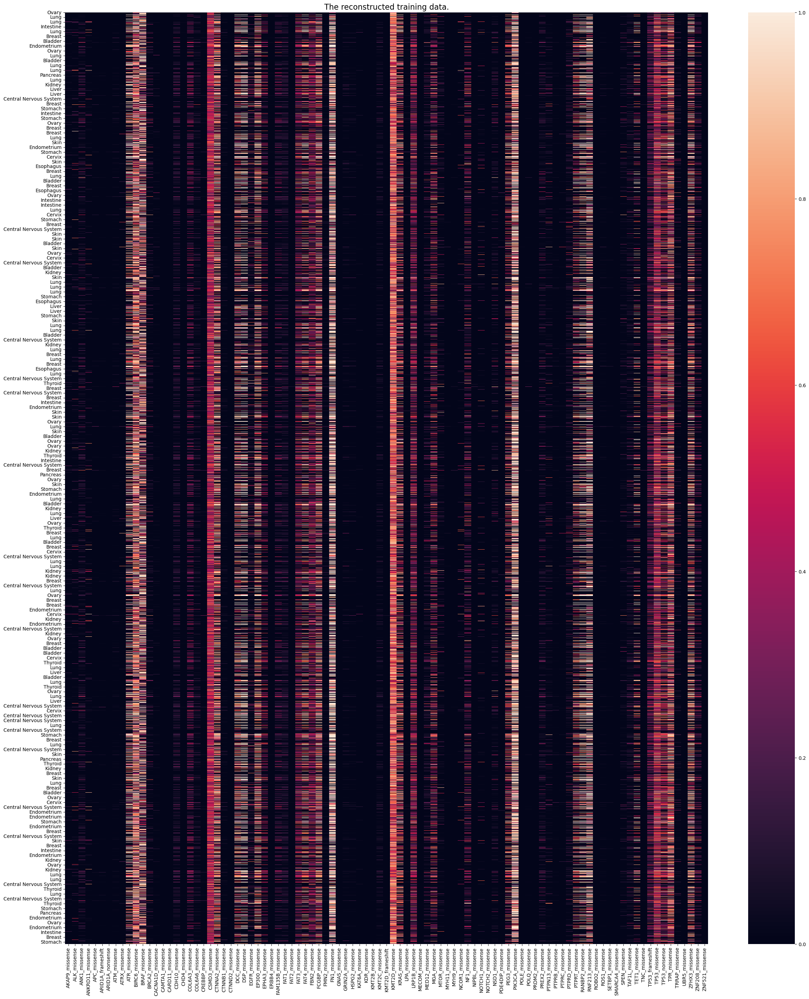

In [73]:
import seaborn as sns
plt.figure(figsize=(30,35))
sns.heatmap(reconstructed_x_train)
plt.title('The reconstructed training data.', fontsize=16)
#plt.savefig('final_plots/binaary_reconst_X_train.png')
plt.show()

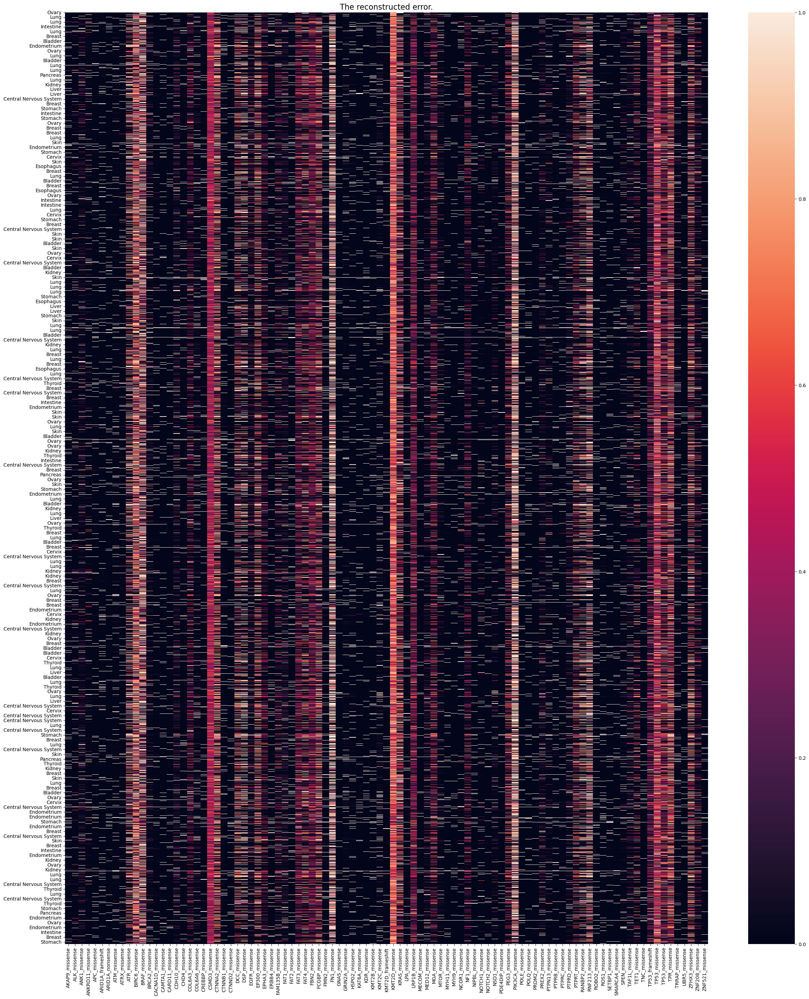

In [74]:
reconstruction_error = np.abs(X_train - decoder_data)
reconstruction_error = pd.DataFrame(reconstruction_error)
reconstruction_error.columns = mutation_list
reconstruction_error.index = x_train_cancer_type

plt.figure(figsize=(30,35))
sns.heatmap(reconstruction_error)
plt.title('The reconstructed error.', fontsize=16)
#plt.savefig('final_plots/binaary_reconst_error.png')
plt.show()

In [75]:
from keras.losses import binary_crossentropy

reconst_error = np.mean(binary_crossentropy(X_train, decoder_data),axis=-1).astype('float32')
reconst_error

0.56527835

In [76]:
binary_x_train = X_train
binary_x_test= X_test
binary_x_test

array([[0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 0.],
       [1., 1., 1., ..., 1., 1., 1.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

#### PCA
1. Use the encoder output of the autoencoder to predict on the x_test data.
2. Use the predicted x_test data and further reduce its dimentionality using PCA.

In [77]:
from sklearn.preprocessing import scale,MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder

In [78]:
x_predict = model_encoder.predict(X_test)
print(x_predict)

25/25 [==============================] - 0s 1ms/step
[[ 1.3692523 11.078225   2.0027728 ... 12.0110655  9.215667  10.431389 ]
 [ 1.2907263  9.03297    0.3371639 ... 10.37832    6.9602656 13.787524 ]
 [18.360949  29.783258   0.        ... 23.057034   0.        58.045883 ]
 ...
 [ 1.1680343 13.4592705  4.2750916 ... 15.860655  13.66565    8.8356   ]
 [ 2.814418  11.006916   0.        ...  9.684369   8.536317   4.8872147]
 [ 5.3973775 16.5542     4.0846596 ... 15.325049  17.381798   6.852103 ]]


In [79]:
x_predict_df = pd.DataFrame(x_predict)
x_predict_df.index = x_test_cancer_type
x_predict_df.head()

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Ovary,1.369252,11.078225,2.002773,0.0,3.929633,2.175969,5.798051,1.933367,5.514975,0.000000,...,9.998109,2.939544,7.252106,0.000000,7.534293,4.293005,6.755954,12.011065,9.215667,10.431389
Skin,1.290726,9.032970,0.337164,0.0,4.634168,0.754642,5.632277,0.000000,6.428786,1.174803,...,8.824053,1.836124,3.163091,0.034669,6.581285,3.540970,6.671828,10.378320,6.960266,13.787524
Intestine,18.360949,29.783258,0.000000,0.0,0.000000,0.000000,14.217727,0.000000,16.574331,14.745935,...,6.606586,6.757869,0.000000,0.000000,27.252771,6.038451,6.937500,23.057034,0.000000,58.045883
Stomach,6.504556,9.640285,0.000000,0.0,0.000000,0.000000,4.412312,0.000000,3.974911,4.460581,...,1.881311,1.610487,0.000000,0.000000,6.805948,2.366050,1.329277,5.507599,0.000000,17.278923
Breast,2.070016,11.661701,4.767731,0.0,6.791235,6.152137,7.605739,1.542005,10.505799,7.309487,...,11.914012,4.478314,11.065250,4.890789,1.462237,6.752357,5.881632,10.822812,14.189860,3.607177


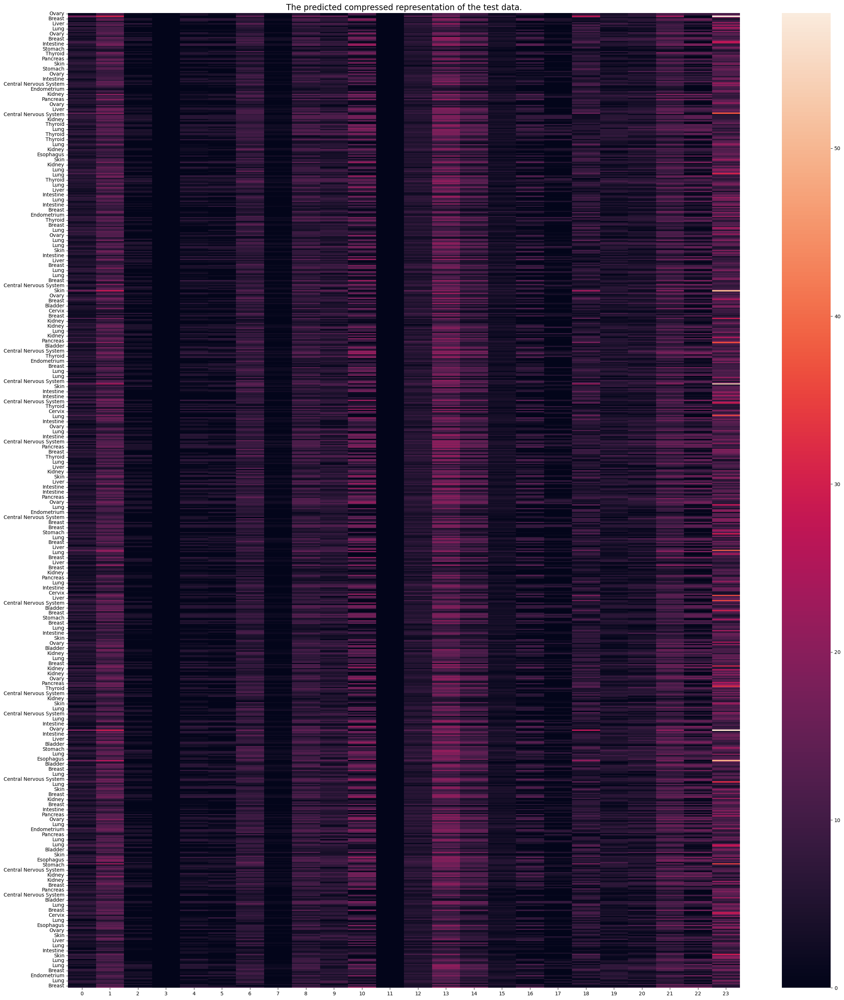

In [80]:
plt.figure(figsize=(30,35))
sns.heatmap(x_predict_df)
plt.title('The predicted compressed representation of the test data.', fontsize=16)
#plt.savefig('final_plots/compressed_test_data.png')
plt.show()

In [81]:
# Perform pca analysis
pca=PCA(n_components=4)
encoder_pca = pca.fit_transform(scale(x_predict))

C:\Users\tes2s\anaconda3\Lib\site-packages\sklearn\preprocessing\_data.py:247: UserWarning:

Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.

C:\Users\tes2s\anaconda3\Lib\site-packages\sklearn\preprocessing\_data.py:266: UserWarning:

Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 



In [82]:
#pca df 
pca_df = pd.DataFrame(encoder_pca, columns=['PCA_component1','PCA_component2','PCA_component3','PCA_component4'])
pca_df['Cancer Type'] = x_test_cancer_type

#Change the cancer type name in to number label
label_coder = LabelEncoder()
pca_df['Cancer Type'] = label_coder.fit_transform(pca_df['Cancer Type'])

pca_df

,PCA_component1,PCA_component2,PCA_component3,PCA_component4,Cancer Type
0,0.535947,-1.568671,-0.650532,-2.908482,10
1,-0.976958,-0.999261,-0.706769,-1.954728,12
2,2.351751,13.330487,-1.447417,0.204499,6
3,-4.327013,0.333602,-0.504166,0.325164,13
4,4.404727,-2.366156,0.401744,0.384319,1
...,...,...,...,...,...
769,1.656773,0.475415,2.271539,3.602284,2
770,-4.146257,-0.031753,0.310754,-0.311932,6
771,3.083178,-1.757089,-0.568405,-3.059039,6
772,-2.145604,-2.646047,-2.576390,0.582554,1


In [83]:
#Change the cancer type name in to number label

label_coder = LabelEncoder()
cancer_code = label_coder.fit_transform(pca_df['Cancer Type'])

#get the unique cancer types
df_coded_cancer = pd.DataFrame([cancer_code, x_test_cancer_type]).transpose().drop_duplicates()
df_coded_cancer.index= df_coded_cancer[0]
df_coded_cancer.drop(columns=[0], inplace=True)

#change the df to dict
dict_df_coded_cancer = df_coded_cancer.to_dict()
dict_df_coded_cancer

{1: {10: 'Ovary',
  12: 'Skin',
  6: 'Intestine',
  13: 'Stomach',
  1: 'Breast',
  4: 'Endometrium',
  8: 'Liver',
  0: 'Bladder',
  9: 'Lung',
  2: 'Central Nervous System',
  11: 'Pancreas',
  14: 'Thyroid',
  7: 'Kidney',
  5: 'Esophagus',
  3: 'Cervix'}}

In [84]:
pca_df['Cancer Name'] = pca_df['Cancer Type'].map(dict_df_coded_cancer[1])
pca_df

,PCA_component1,PCA_component2,PCA_component3,PCA_component4,Cancer Type,Cancer Name
0,0.535947,-1.568671,-0.650532,-2.908482,10,Ovary
1,-0.976958,-0.999261,-0.706769,-1.954728,12,Skin
2,2.351751,13.330487,-1.447417,0.204499,6,Intestine
3,-4.327013,0.333602,-0.504166,0.325164,13,Stomach
4,4.404727,-2.366156,0.401744,0.384319,1,Breast
...,...,...,...,...,...,...
769,1.656773,0.475415,2.271539,3.602284,2,Central Nervous System
770,-4.146257,-0.031753,0.310754,-0.311932,6,Intestine
771,3.083178,-1.757089,-0.568405,-3.059039,6,Intestine
772,-2.145604,-2.646047,-2.576390,0.582554,1,Breast


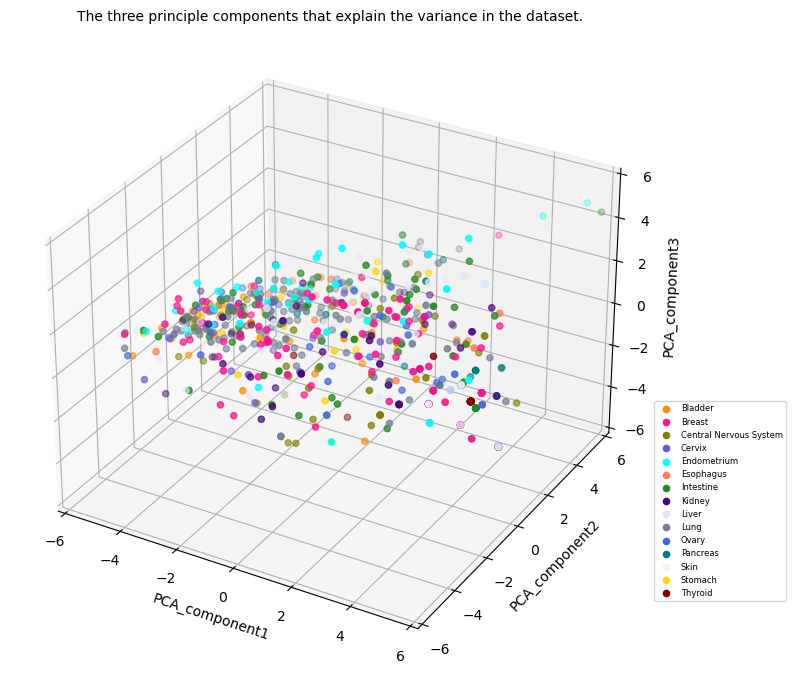

In [85]:
color = {'Ovary':'royalblue', 'Skin':'linen','Intestine':'forestgreen', 'Stomach':'gold', 'Breast':'deeppink', 
       'Endometrium':'cyan', 'Liver':'lavender', 'Bladder':'darkorange', 'Lung':'slategray', 'Central Nervous System':'olive', 
        'Pancreas':'teal', 'Thyroid':'maroon', 'Kidney':'indigo', 'Esophagus':'coral', 'Cervix':'slateblue'}

fig = plt.figure (figsize=(8,10))
ax = fig.add_subplot(projection='3d')

y=pca_df['Cancer Name']

for cancer_name, group in pca_df.groupby('Cancer Name'):
    ax.scatter(group['PCA_component1'],
               group['PCA_component2'],
               group['PCA_component3'], 
               c=color[cancer_name], 
               label=cancer_name)
    
ax.set_xlim([-6, 6])  
ax.set_ylim([-6, 6])  
ax.set_zlim([-6, 6])
ax.set_xlabel('PCA_component1')
ax.set_ylabel('PCA_component2')
ax.set_zlabel('PCA_component3')
ax.legend(loc='lower left', bbox_to_anchor=(1,0.1),fontsize=6)
ax.set_title('The three principle components that explain the variance in the dataset.', fontsize=10)

plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

fig.set_size_inches(11, 8) 
#plt.savefig('final_plots/three_principle_components_binary.png')
plt.show()



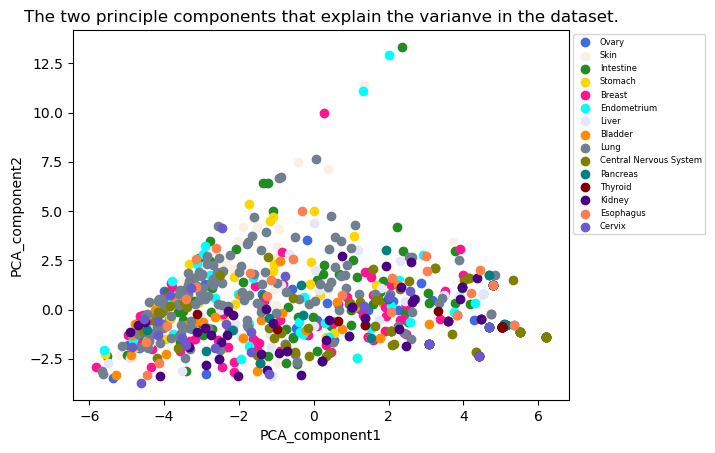

In [86]:
color = ['royalblue', 'linen', 'forestgreen', 'gold', 'deeppink', 
        'cyan', 'lavender', 'darkorange', 'slategray', 'olive', 
        'teal', 'maroon', 'indigo', 'coral', 'slateblue']
         
         
unique_cancer_types = pca_df['Cancer Name'].unique()

# Plot each cancer type using the cancer name column

for i, cancer_type in enumerate(unique_cancer_types):
    #filter the data based on cancer name
    filtered_data = pca_df[pca_df['Cancer Name'] == cancer_type]
    
    #plot the two components
    plt.scatter(x=filtered_data['PCA_component1'], y=filtered_data['PCA_component2'], c=color[i], label=cancer_type)


plt.legend(loc='upper left', bbox_to_anchor=(1,1),fontsize=6)
plt.xlabel('PCA_component1')
plt.ylabel('PCA_component2')
plt.title('The two principle components that explain the varianve in the dataset.')
plt.show()

#### Multiclass autoencoder

In [87]:
#grouping
def grouping_by_number(df):
        df1 = df.copy()
        df1 = np.where((df1 < 0.06), 0, df1)
        df2 = np.where(((df1 > 0.05) & (df1 <= 0.15)), 1, df1)
        df3 = np.where (((df2 > 0.15) & (df2 <= 0.65)), 2, df2)
        df4 = np.where (((df3 > 0.65) & (df3 < 1.0)), 4, df3) 
        df = pd.DataFrame(df4)
        return df


In [88]:
#cell line sample
cell_conv = pd.read_csv('CellLine_Mutations.tsv', sep='\t', header=None)
cell_conv = grouping_by_number(cell_encode).transpose()

#tissue sample
tissue_conv = pd.read_csv('Patient_Mutations.tsv', sep='\t', header=None)
tissue_conv = grouping_by_number(tissue_encode).transpose()

#combine the cancer tissue names
conv_cancer_types = cell_cancer_type + tissue_cancer_type

#combine the dataset and add a cancer type column(the combined list)

input_conv_df = pd.concat((cell_conv, tissue_conv), axis=0)
input_conv_df['cancer_type'] = conv_cancer_types
print(input_conv_df.shape)

(7736, 96)


In [89]:
#Set random seed 
np.random.seed(101)
tf.random.set_seed(101)

#split the train and test data
X_train, X_test = train_test_split(input_conv_df, test_size=0.2, random_state=101)

x_train_con_type= X_train['cancer_type'].to_list()
x_test_con_type = X_test['cancer_type'].to_list()

X_train = X_train.drop(['cancer_type'], axis=1)
X_test = X_test.drop(['cancer_type'], axis=1)


X_train = X_train.values
X_test = X_test.values


#Hot encode the data
X_train= tf.one_hot(X_train, depth=4)
X_test = tf.one_hot(X_test,depth=4)



#sum up the positive(mutated) and negative(not mutated) mutations 

def mutli_weight_ratio(X_train):
    input_yes = np.sum(X_train[:,:,:], axis=0).astype('float32') #mutated genes

    input_no = np.sum(1 - X_train[:,:,:], axis=0).astype('float32') #not mutated genes

    prop = input_yes/input_no
    return prop


#loss function

def cust_loss_in(y_true, y_pred):
    y_pred = tf.clip_by_value(y_pred, tf.keras.backend.epsilon(), 1.0-tf.keras.backend.epsilon()) 
    w_score = -1.0*tf.math.multiply(y_true, tf.math.multiply(tf.math.log(y_pred), 1.0/tf.clip_by_value(tf.expand_dims(cat_w, axis=0), tf.keras.backend.epsilon(), 1.0))) 
    w_score_neg = -1.0*tf.math.multiply(1.0-y_true, tf.math.log(1.0 - y_pred)) 
    cce = tf.math.reduce_sum(w_score+w_score_neg, axis=-1)
    return cce

def cust_loss_cat(cat_w):
    def cust_loss_in(y_true, y_pred):
        y_pred = tf.clip_by_value(y_pred, tf.keras.backend.epsilon(), 1.0-tf.keras.backend.epsilon()) 
        w_score = -1.0*tf.math.multiply(y_true, tf.math.multiply(tf.math.log(y_pred), 1.0/tf.clip_by_value(tf.expand_dims(cat_w, axis=0), tf.keras.backend.epsilon(), 1.0))) 
        w_score_neg = -1.0*tf.math.multiply(1.0-y_true, tf.math.log(1.0 - y_pred)) 
        cce = tf.math.reduce_sum(w_score+w_score_neg, axis=-1)
        return cce
    return cust_loss_in

#register the loss function
tf.keras.utils.get_custom_objects()['weight_ratio'] = weight_ratio
tf.keras.utils.get_custom_objects()['cust_loss_in'] = cust_loss_in
tf.keras.utils.get_custom_objects()['cust_loss_cat'] = cust_loss_cat


#multiclass encoder

encoder_input = keras.Input(shape=(95, 4))

conv1 = keras.layers.Conv1D(1, (1,), activation='gelu')(encoder_input)

x1 = keras.layers.Flatten()(conv1)

x2 = keras.layers.Dense(64, activation='gelu')(x1)

x3 = keras.layers.Dense(64, activation='gelu')(x2)

x4 = keras.layers.Dense(32, activation='gelu')(x3)


encoder_output = keras.layers.Dense(32, activation='linear')(x4)


b1 = keras.layers.BatchNormalization()

encoder_out_b1= b1(encoder_output)

#encoder only model
encoder = keras.Model(encoder_input, encoder_output, name='encoder')

decoder_input = keras.Input(shape=32,)

y1 = keras.layers.Dense(32, activation='gelu')(encoder_out_b1)

y2 = keras.layers.Dense(64, activation='gelu')(y1)

y3 = keras.layers.Dense(64, activation='gelu')(y2)

y4 = keras.layers.Dense(95, activation='gelu')(y3)
 
y4 = tf.expand_dims(y4, axis=-1)

decoder_output = keras.layers.Conv1D(4, 1, padding='valid', activation='softmax')(y4)

#decoder only model
decoder = keras.Model(encoder_output, decoder_output, name='decoder')


autoencoder_input = keras.Input(shape=(95,4))

encoder_output = encoder(autoencoder_input)

decoder_output = decoder(encoder_output)

#combined model
autoencoder = keras.Model(autoencoder_input, decoder_output, name='autoencoder')



opt = keras.optimizers.Adam(learning_rate=0.0001)




#encoder.compile(opt, loss=cust_loss_cat(weight_ratio(X_train)), metrics=['accuracy'])
#decoder.compile(opt, loss=cust_loss_cat(weight_ratio(X_train)), metrics = ['accuracy'])
#autoencoder.compile(opt, loss=cust_loss_cat(weight_ratio(X_train)), metrics=['accuracy'])

autoencoder.summary()

#history1 = autoencoder.fit(X_train, X_train, epochs=150, batch_size=1000, validation_split=0.2, shuffle=True)


Model: "autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 95, 4)]           0         
                                                                 
 encoder (Functional)        (None, 32)                13445     
                                                                 
 decoder (Functional)        (None, 95, 4)             13639     
                                                                 
Total params: 27084 (105.80 KB)
Trainable params: 27020 (105.55 KB)
Non-trainable params: 64 (256.00 Byte)
_________________________________________________________________


In [90]:
# fig, axs = plt.subplots(1,2,figsize=(12,4))

# axs[0].plot(history1.history["loss"], label="Training Loss")
# axs[0].plot(history1.history["val_loss"], label="Validation Loss")

# axs[0].set_title('Multi class autoencoder training and validation loss.', fontsize=10)
# axs[0].set_xlabel('Epoch',fontsize=(8))
# axs[0].set_ylabel('Loss', fontsize=(8))
# axs[0].legend(loc='upper right',fontsize=8)



# axs[1].plot(history1.history['accuracy'], label="Training Accuracy")
# axs[1].plot(history1.history['val_accuracy'], label="Validation Acuracy")

# axs[1].set_title('Multi class autoencoder training and validation accuarcy.', fontsize=10)
# axs[1].set_xlabel('Epoch',fontsize=(8))
# axs[1].set_ylabel('Accuracy', fontsize=(8))
# axs[1].legend(loc='lower right',fontsize=8)

# plt.savefig('final_plots/multi_class_accuracy_and_loss_final.png')

In [91]:
X_train.shape

TensorShape([6188, 95, 4])

In [92]:
#saves the trained models
#encoder_multi_cl_model = encoder.save('multi_encoder_model.h5')
#decoder_multi_cl_model = decoder.save('multi_decoder_model.h5')
#multi_auto_encoder_model = autoencoder.save('multi_autoencoder.h5')

In [93]:
#reload the training models
multi_auto = load_model('multi_autoencoder.h5')
multi_encoder = load_model('multi_encoder_model.h5')
multi_decoder = load_model('multi_decoder_model.h5')

In [94]:
#Reconstract the training data
encoder_multi = multi_encoder(X_train).numpy().astype('float32')
decoder_multi = multi_decoder(encoder_multi).numpy().astype('float32')

In [95]:
# the decoder_multi has the hot encoded vector result of [0,1,2,3] category
#decoder_multi

In [96]:
#Create a df for each catagory (mutation No)
reconst_multi_x_train_0 = pd.DataFrame(decoder_multi[:,:,0])
reconst_multi_x_train_0.columns = mutation_list
reconst_multi_x_train_0.index = x_train_con_type
reconst_multi_x_train_0.head(2)

,AKAP9_missense,ALK_missense,ANK1_missense,ANKRD11_missense,APC_missense,ARID1A_frameshift,ARID1A_nonsense,ATM_missense,ATRX_missense,ATR_missense,...,TNC_missense,TP53_frameshift,TP53_missense,TP53_nonsense,TPR_missense,TRRAP_missense,UBR5_missense,ZFHX3_missense,ZNF208_missense,ZNF521_missense
Bladder,0.706765,0.674884,0.550093,0.741437,0.51578,0.346024,0.350745,0.447614,0.552971,0.552706,...,0.264880,0.420732,0.367038,0.464425,0.488665,0.524897,0.485864,0.555762,0.457809,0.534557
Kidney,0.918393,0.950242,0.900026,0.955755,0.74058,0.656831,0.711688,0.761216,0.793768,0.763411,...,0.731043,0.753753,0.693685,0.702766,0.850215,0.902042,0.846931,0.738048,0.674232,0.723144


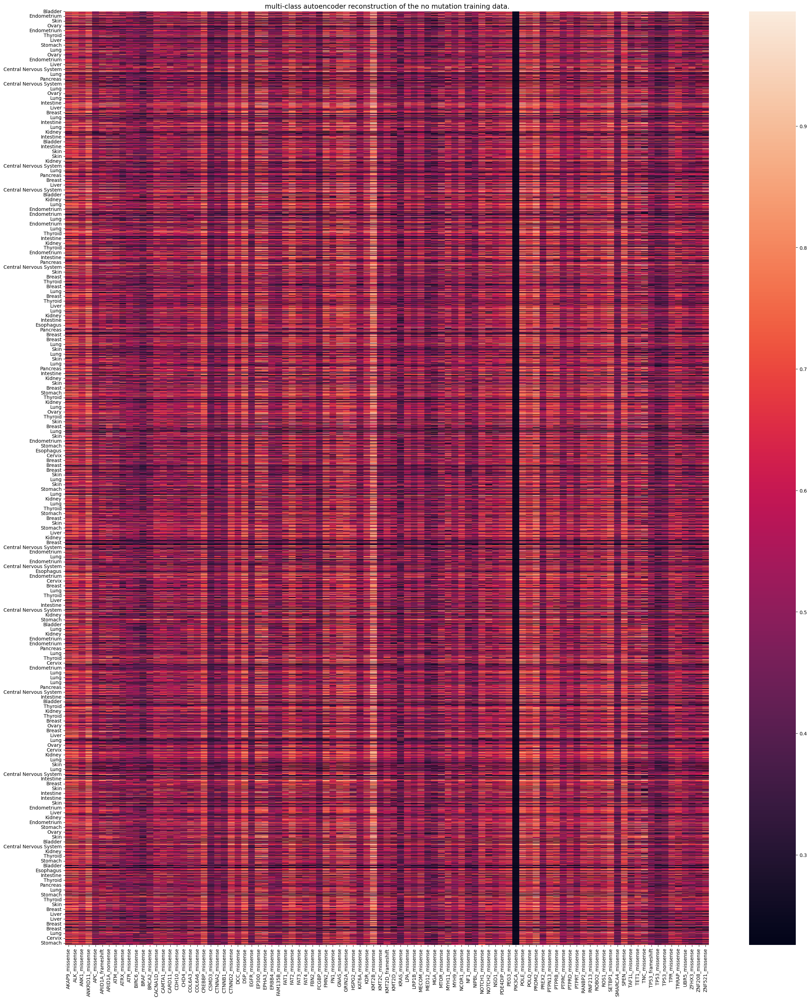

In [97]:
#Plot the constructed data for No mutation (0)
plt.figure(figsize=(30,35))
sns.heatmap(reconst_multi_x_train_0)

plt.title('multi-class autoencoder reconstruction of the no mutation training data.', fontsize=14)
#plt.savefig('final_plots/multi-class_autoencoder_no_mutation.png')
plt.show()

<Axes: >

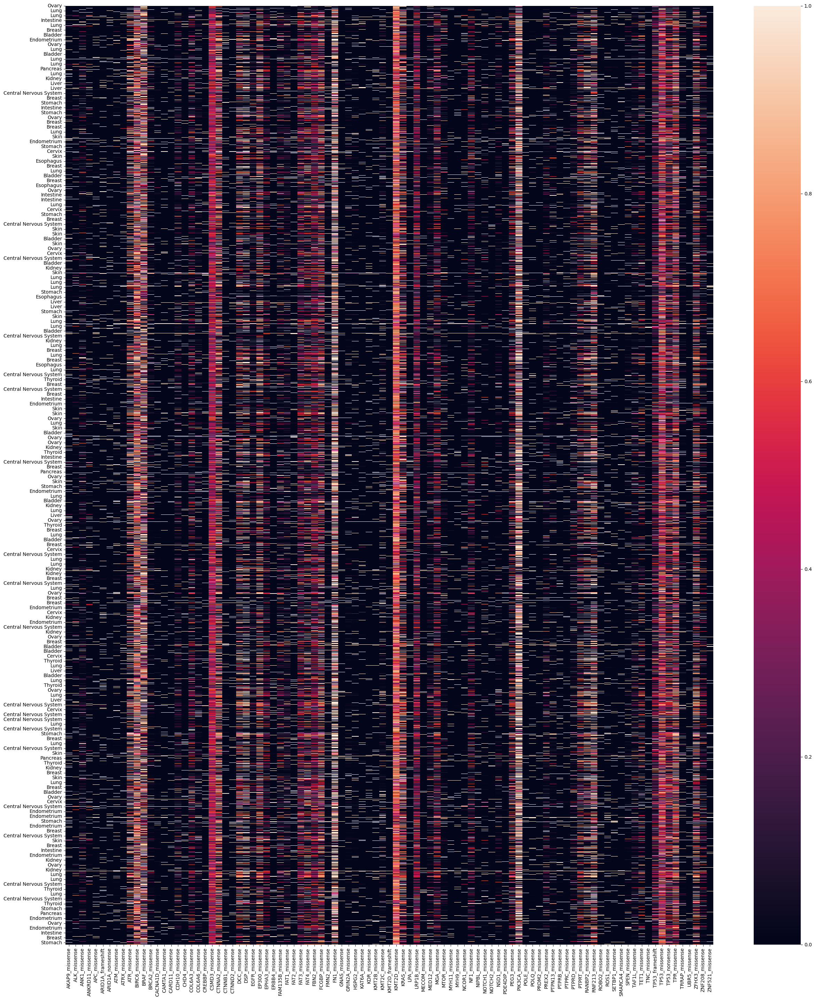

In [98]:
#Plot the reconstraction error
reconst_multi_error = np.abs(X_train[:,:,0] - reconst_multi_x_train_0)
reconst_multi_error = pd.DataFrame(reconstruction_error)
reconst_multi_error.columns = mutation_list
reconst_multi_error.index = x_train_cancer_type

plt.figure(figsize=(30,35))
sns.heatmap(reconst_multi_error)

In [99]:
#reconstruction error
reconst_error = np.mean(binary_crossentropy(X_train[:,:,0], decoder_multi[:,:,0]),axis=-1).astype('float32')
print(f'The reconstruction error is {reconst_error} for no mutation samples.')

The reconstruction error is 0.6891927123069763 for no mutation samples.


In [100]:
#multi class autoencoder reconstruction of the training data(low muation)
reconst_multi_x_train_1 = pd.DataFrame(decoder_multi[:,:,1])
reconst_multi_x_train_1.columns = mutation_list
reconst_multi_x_train_1.index = x_train_con_type
reconst_multi_x_train_1

,AKAP9_missense,ALK_missense,ANK1_missense,ANKRD11_missense,APC_missense,ARID1A_frameshift,ARID1A_nonsense,ATM_missense,ATRX_missense,ATR_missense,...,TNC_missense,TP53_frameshift,TP53_missense,TP53_nonsense,TPR_missense,TRRAP_missense,UBR5_missense,ZFHX3_missense,ZNF208_missense,ZNF521_missense
Bladder,0.015888,0.022529,0.063216,0.010248,0.078728,0.185479,0.181775,0.115375,0.062002,0.062113,...,0.256973,0.132045,0.169344,0.105599,0.092361,0.074418,0.093839,0.060838,0.109388,0.070001
Kidney,0.000135,0.000021,0.000293,0.000013,0.010368,0.026941,0.014989,0.007716,0.004526,0.007464,...,0.011773,0.008616,0.018438,0.016642,0.001367,0.000271,0.001484,0.010730,0.022680,0.013026
Intestine,0.003287,0.001717,0.003468,0.002107,0.067756,0.006488,0.016172,0.006043,0.024778,0.018248,...,0.002962,0.014941,0.180482,0.102097,0.015634,0.004538,0.030033,0.059594,0.011429,0.008710
Kidney,0.102424,0.047836,0.067579,0.030424,0.151653,0.132260,0.108879,0.116768,0.129884,0.086129,...,0.093554,0.155345,0.220080,0.164375,0.072037,0.063440,0.186077,0.183618,0.159463,0.118028
Lung,0.179721,0.095351,0.121614,0.077186,0.198405,0.092187,0.078692,0.099765,0.133878,0.170634,...,0.045873,0.169234,0.214325,0.207406,0.159735,0.155176,0.206163,0.234849,0.133457,0.146848
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Skin,0.120093,0.073306,0.053495,0.140794,0.174846,0.088803,0.032288,0.197813,0.081895,0.102647,...,0.068399,0.095809,0.252334,0.065306,0.142492,0.031574,0.231911,0.170784,0.113896,0.169948
Central Nervous System,0.032221,0.026332,0.037158,0.016141,0.072403,0.026296,0.064306,0.060603,0.127954,0.132970,...,0.012855,0.126333,0.074412,0.073420,0.047199,0.048750,0.052439,0.070046,0.049391,0.021833
Lung,0.015270,0.014623,0.012149,0.004983,0.056178,0.009861,0.028429,0.017588,0.059293,0.103206,...,0.001851,0.075403,0.062203,0.052432,0.013095,0.020951,0.017467,0.047563,0.028220,0.005685
Bladder,0.157314,0.102510,0.073519,0.058920,0.146921,0.095742,0.071123,0.102528,0.141990,0.184462,...,0.039000,0.232485,0.140313,0.127958,0.059446,0.197484,0.116944,0.135794,0.157152,0.083290


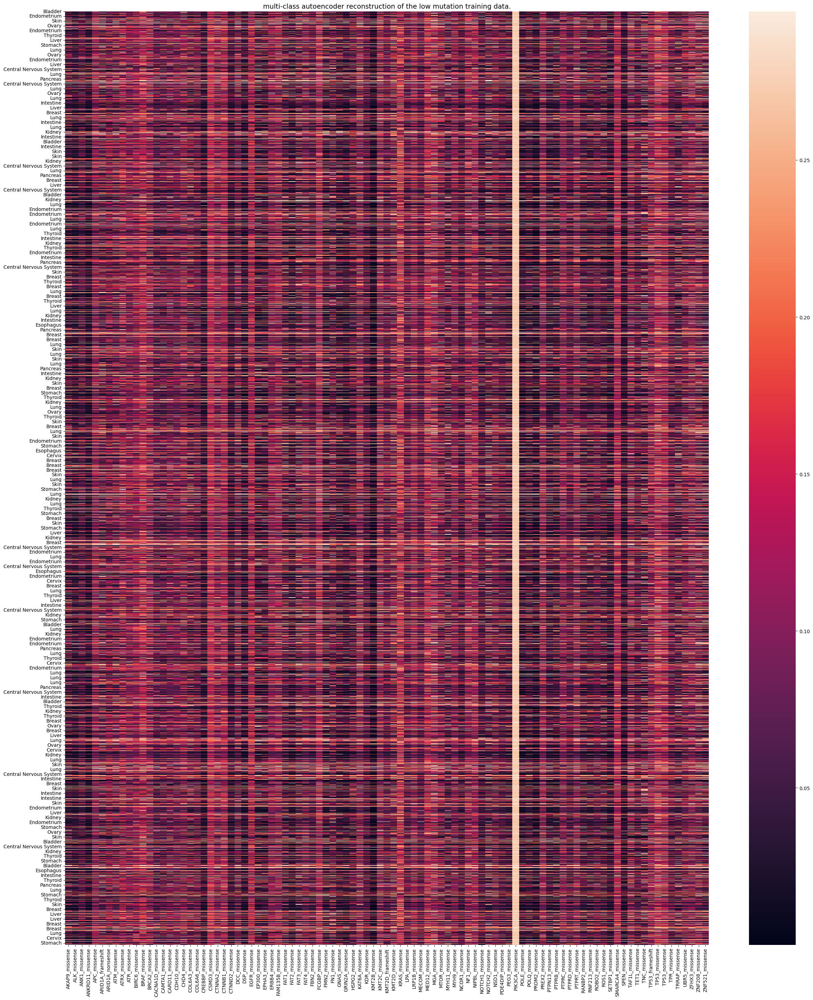

In [101]:
plt.figure(figsize=(30,35))
sns.heatmap(reconst_multi_x_train_1)

plt.title('multi-class autoencoder reconstruction of the low mutation training data.', fontsize=14)
#plt.savefig('final_plots/multi-class_autoencoder_low_mutation.png')
plt.show()

<Axes: >

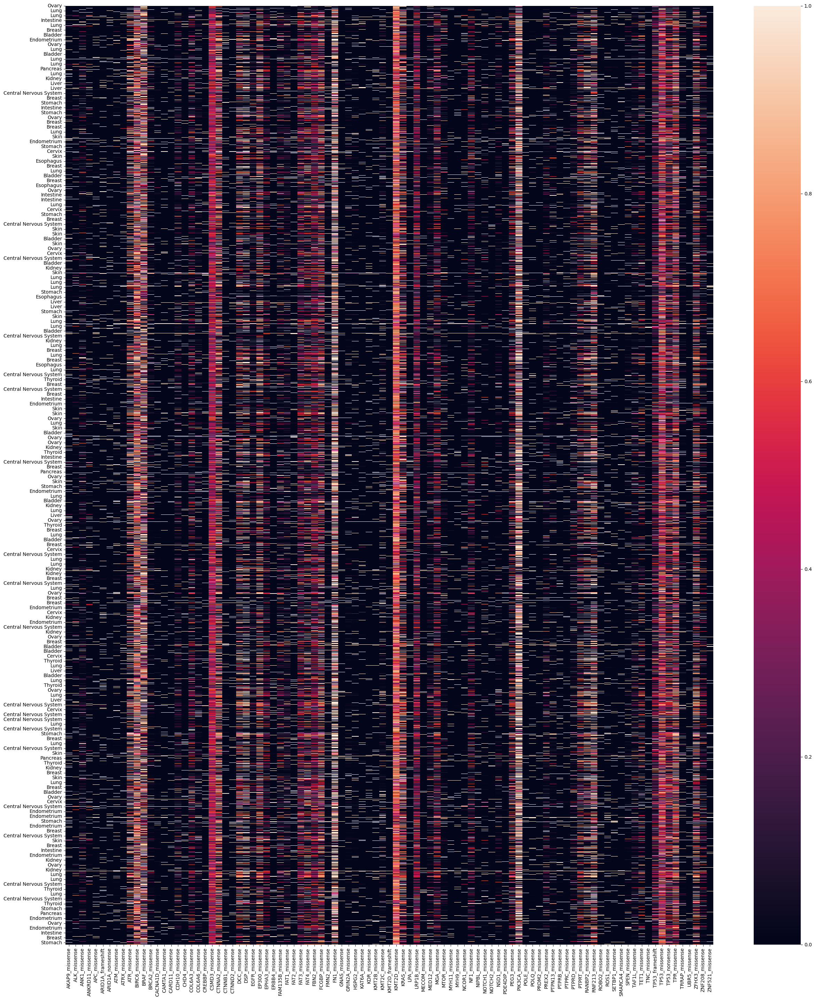

In [102]:
#Reconstruction error heatmap (mutation Low)
reconst_multi_error = np.abs(X_train[:,:,1] - reconst_multi_x_train_1)
reconst_multi_error = pd.DataFrame(reconstruction_error)
reconst_multi_error.columns = mutation_list
reconst_multi_error.index = x_train_cancer_type

plt.figure(figsize=(30,35))
sns.heatmap(reconst_multi_error)

In [103]:
#reconstruction error
reconst_error = np.mean(binary_crossentropy(X_train[:,:,1], decoder_multi[:,:,1]),axis=-1).astype('float32')
print(f'The reconstruction error is {reconst_error} for low mutation samples.')

The reconstruction error is 0.12568144500255585 for low mutation samples.


In [104]:
#multi class autoencoder reconstruction of the training data(medium muation)
reconst_multi_x_train_2 = pd.DataFrame(decoder_multi[:,:,2])
reconst_multi_x_train_2.columns = mutation_list
reconst_multi_x_train_2.index = x_train_con_type
reconst_multi_x_train_2

,AKAP9_missense,ALK_missense,ANK1_missense,ANKRD11_missense,APC_missense,ARID1A_frameshift,ARID1A_nonsense,ATM_missense,ATRX_missense,ATR_missense,...,TNC_missense,TP53_frameshift,TP53_missense,TP53_nonsense,TPR_missense,TRRAP_missense,UBR5_missense,ZFHX3_missense,ZNF208_missense,ZNF521_missense
Bladder,0.244026,0.259518,0.296225,0.224229,0.300075,0.283449,0.284689,0.300368,0.295785,0.295827,...,0.255037,0.297885,0.288628,0.301182,0.301342,0.299300,0.301385,0.295342,0.300930,0.298284
Kidney,0.080553,0.049517,0.098025,0.044074,0.224756,0.267151,0.241402,0.211566,0.188615,0.210100,...,0.230487,0.216459,0.250695,0.246111,0.143100,0.096126,0.145926,0.226300,0.259808,0.235057
Intestine,0.175570,0.151057,0.177718,0.158493,0.297674,0.203965,0.244822,0.200881,0.263614,0.250231,...,0.171459,0.241256,0.285115,0.301338,0.243301,0.188718,0.271629,0.294843,0.229145,0.216946
Kidney,0.301327,0.288650,0.297623,0.272154,0.293557,0.297845,0.300969,0.300210,0.298276,0.300968,...,0.301378,0.292601,0.270631,0.290098,0.298782,0.296304,0.283247,0.284076,0.291488,0.300059
Lung,0.285364,0.301413,0.299587,0.299821,0.278907,0.301336,0.300070,0.301399,0.297539,0.288236,...,0.287307,0.288661,0.272901,0.275563,0.291412,0.292646,0.276033,0.264590,0.297620,0.294739
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Skin,0.299795,0.299067,0.291991,0.296121,0.286929,0.301168,0.274530,0.279122,0.300521,0.301319,...,0.297856,0.301418,0.257086,0.296929,0.295746,0.273641,0.265815,0.288190,0.300524,0.288445
Central Nervous System,0.274447,0.266192,0.279929,0.244735,0.298866,0.266134,0.296601,0.295249,0.298608,0.297712,...,0.234461,0.298875,0.299299,0.299091,0.288225,0.289240,0.291423,0.298296,0.289642,0.258152
Lung,0.242237,0.240286,0.231909,0.192645,0.293332,0.222500,0.269385,0.248588,0.294718,0.301297,...,0.153758,0.299495,0.295860,0.291419,0.235299,0.256346,0.248277,0.288469,0.269080,0.198256
Bladder,0.292075,0.301324,0.299112,0.294562,0.294722,0.301417,0.298565,0.301323,0.295857,0.283793,...,0.281707,0.265577,0.296225,0.298607,0.294782,0.279241,0.300189,0.297164,0.292119,0.300687


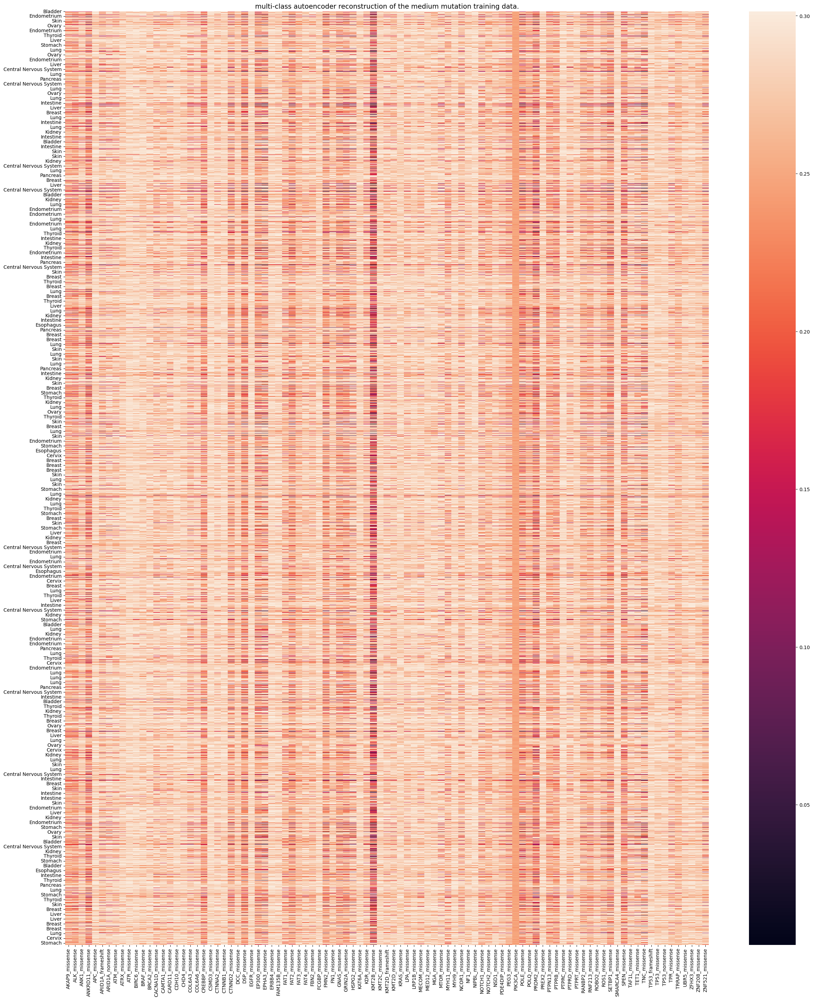

In [105]:
plt.figure(figsize=(30,35))
sns.heatmap(reconst_multi_x_train_2)

plt.title('multi-class autoencoder reconstruction of the medium mutation training data.', fontsize=14)
#plt.savefig('final_plots/multi-class_autoencoder_medium_mutation.png')
plt.show()

<Axes: >

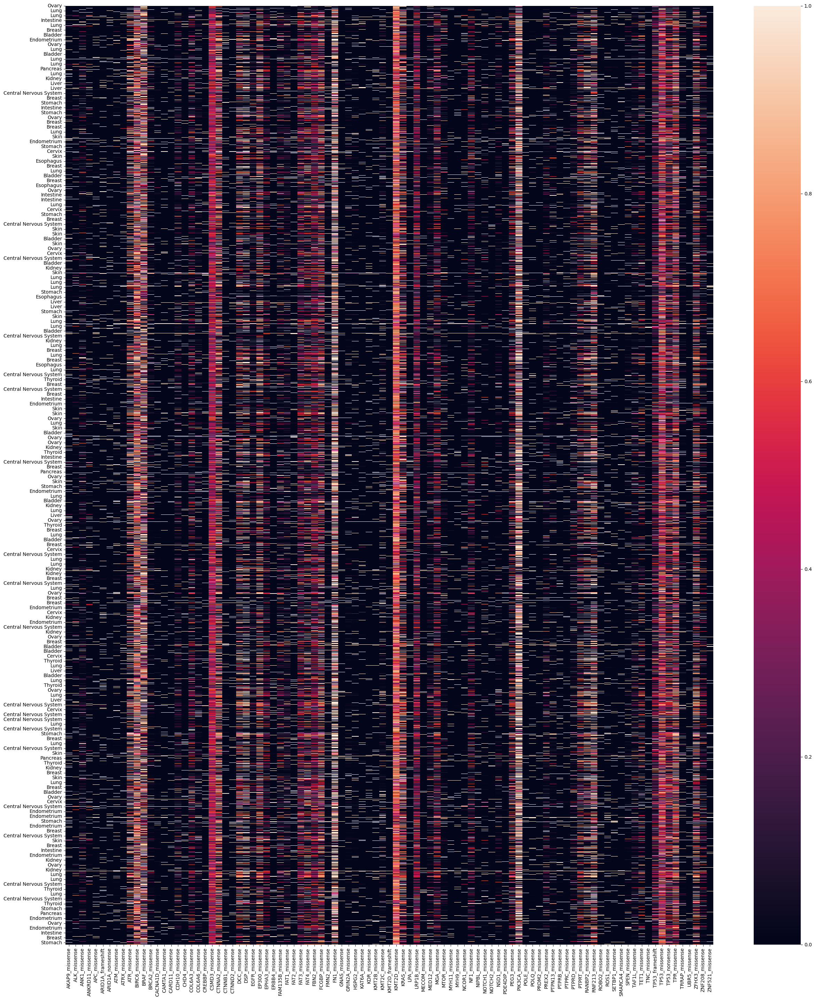

In [106]:
reconst_multi_error = np.abs(X_train[:,:,2] - reconst_multi_x_train_2)
reconst_multi_error = pd.DataFrame(reconstruction_error)
reconst_multi_error.columns = mutation_list
reconst_multi_error.index = x_train_cancer_type

plt.figure(figsize=(30,35))
sns.heatmap(reconst_multi_error)

In [107]:
#reconstruction error
reconst_error = np.mean(binary_crossentropy(X_train[:,:,2], decoder_multi[:,:,2]),axis=-1).astype('float32')
print(f'The reconstruction error is {reconst_error} for low mutation samples.')

The reconstruction error is 0.3585895895957947 for low mutation samples.


In [108]:
#multi class autoencoder reconstruction of the training data(high muation)
reconst_multi_x_train_3 = pd.DataFrame(decoder_multi[:,:,3])
reconst_multi_x_train_3.columns = mutation_list
reconst_multi_x_train_3.index = x_train_con_type
reconst_multi_x_train_3

,AKAP9_missense,ALK_missense,ANK1_missense,ANKRD11_missense,APC_missense,ARID1A_frameshift,ARID1A_nonsense,ATM_missense,ATRX_missense,ATR_missense,...,TNC_missense,TP53_frameshift,TP53_missense,TP53_nonsense,TPR_missense,TRRAP_missense,UBR5_missense,ZFHX3_missense,ZNF208_missense,ZNF521_missense
Bladder,0.033321,0.043069,0.090466,0.024086,0.105417,0.185047,0.182791,0.136643,0.089242,0.089354,...,0.223110,0.149338,0.174991,0.128794,0.117633,0.101384,0.118912,0.088059,0.131874,0.097157
Kidney,0.000920,0.000220,0.001656,0.000157,0.024296,0.049078,0.031920,0.019502,0.013091,0.019025,...,0.026698,0.021172,0.037182,0.034480,0.005318,0.001561,0.005659,0.024922,0.043280,0.028773
Intestine,0.010297,0.006317,0.010721,0.007371,0.094971,0.017137,0.033759,0.016250,0.046172,0.036898,...,0.009523,0.031844,0.181995,0.125904,0.032928,0.013115,0.053113,0.086787,0.026116,0.021344
Kidney,0.126175,0.074263,0.094797,0.053615,0.163265,0.149496,0.131463,0.137736,0.147738,0.112145,...,0.118666,0.165775,0.204730,0.171773,0.099118,0.090691,0.185409,0.183917,0.168535,0.138721
Lung,0.181526,0.120210,0.141492,0.103984,0.192691,0.117482,0.105383,0.123954,0.150684,0.175817,...,0.072075,0.174920,0.201626,0.197806,0.168716,0.165661,0.197110,0.212398,0.150375,0.159946
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Skin,0.140321,0.100329,0.080409,0.155679,0.178486,0.114519,0.055977,0.192349,0.108325,0.126360,...,0.095600,0.120602,0.220939,0.092555,0.156886,0.055076,0.210906,0.175913,0.135476,0.175378
Central Nervous System,0.055892,0.048267,0.061958,0.033711,0.099468,0.048218,0.091559,0.087820,0.146298,0.150018,...,0.028494,0.145081,0.101379,0.100438,0.073556,0.075272,0.079280,0.097201,0.075975,0.042091
Lung,0.032359,0.031343,0.027327,0.014067,0.083244,0.023407,0.051037,0.035913,0.086478,0.126823,...,0.006686,0.102313,0.089445,0.079273,0.028887,0.040838,0.035730,0.073960,0.050763,0.015526
Bladder,0.167100,0.126247,0.100531,0.086095,0.159997,0.120545,0.098240,0.126261,0.156530,0.184430,...,0.064156,0.211199,0.155336,0.146302,0.086636,0.192159,0.137875,0.152081,0.166991,0.109593


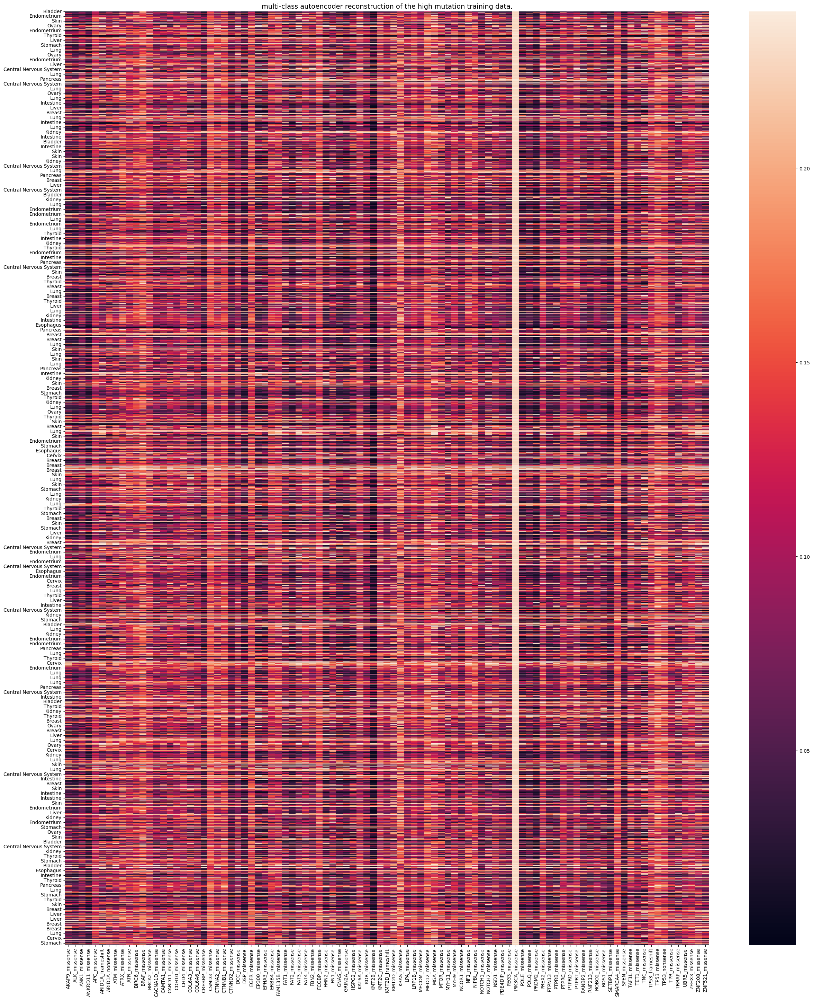

In [109]:
plt.figure(figsize=(30,35))
sns.heatmap(reconst_multi_x_train_3)

plt.title('multi-class autoencoder reconstruction of the high mutation training data.', fontsize=14)
#plt.savefig('final_plots/multi-class_autoencoder_high_mutation.png')
plt.show()

<Axes: >

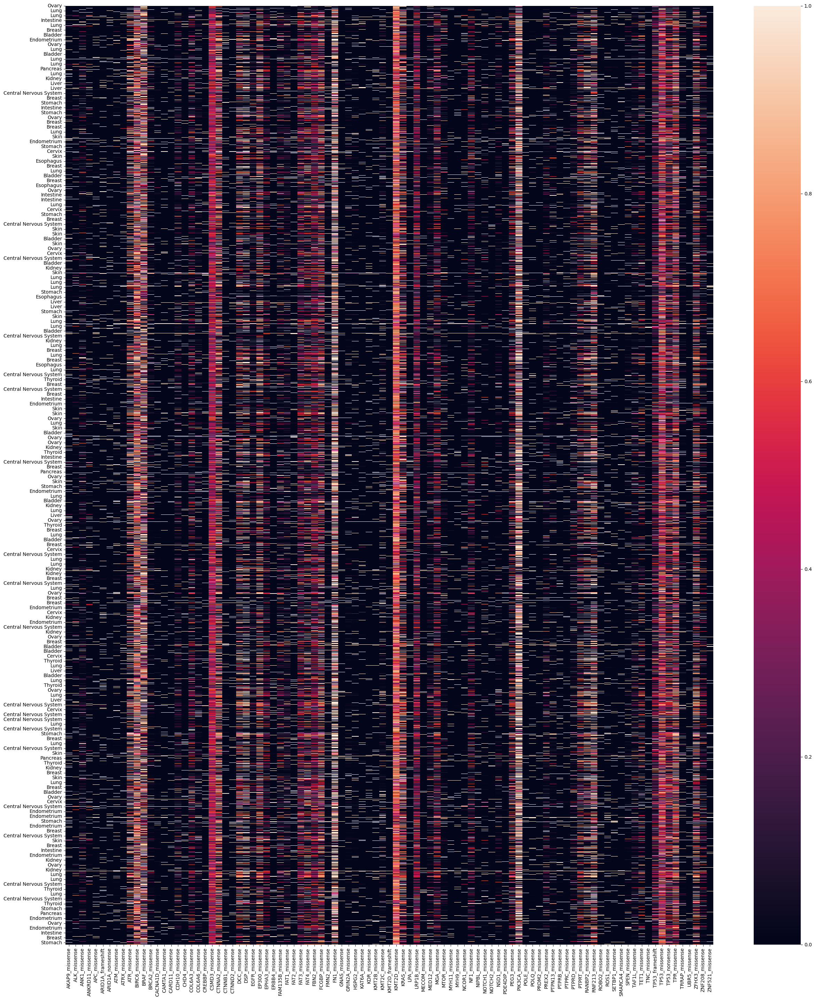

In [110]:
reconst_multi_error = np.abs(X_train[:,:,3] - reconst_multi_x_train_3)
reconst_multi_error = pd.DataFrame(reconstruction_error)
reconst_multi_error.columns = mutation_list
reconst_multi_error.index = x_train_cancer_type

plt.figure(figsize=(30,35))
sns.heatmap(reconst_multi_error)

In [111]:
#reconstruction error
reconst_error = np.mean(binary_crossentropy(X_train[:,:,3], decoder_multi[:,:,3]),axis=-1).astype('float32')
print(f'The reconstruction error is {reconst_error} for low mutation samples.')

The reconstruction error is 0.12086047977209091 for low mutation samples.


In [112]:
# Use the multi_encoder model to predict the test 
multi_x_predict = multi_encoder.predict(X_test)
print(x_predict)

49/49 [==============================] - 0s 1ms/step
[[ 1.3692523 11.078225   2.0027728 ... 12.0110655  9.215667  10.431389 ]
 [ 1.2907263  9.03297    0.3371639 ... 10.37832    6.9602656 13.787524 ]
 [18.360949  29.783258   0.        ... 23.057034   0.        58.045883 ]
 ...
 [ 1.1680343 13.4592705  4.2750916 ... 15.860655  13.66565    8.8356   ]
 [ 2.814418  11.006916   0.        ...  9.684369   8.536317   4.8872147]
 [ 5.3973775 16.5542     4.0846596 ... 15.325049  17.381798   6.852103 ]]


In [113]:
multi_x_predict_df = pd.DataFrame(multi_x_predict)
multi_x_predict_df.index = x_test_con_type
multi_x_predict_df.head()

,0,1,2,3,4,5,6,7,8,9,...,22,23,24,25,26,27,28,29,30,31
Intestine,0.106165,-0.117240,0.132878,0.033180,0.121780,0.102432,-0.010402,0.104338,-0.019202,-0.006211,...,0.076553,-0.044176,-0.041983,-0.039243,0.135479,0.153512,0.057443,0.229061,0.009984,-0.055326
Lung,0.007920,0.074612,0.083872,0.121901,0.017255,-0.041578,-0.122374,0.098049,-0.034269,0.007275,...,0.011290,-0.087457,0.080152,0.072669,0.040968,0.085238,-0.090123,0.181117,-0.025478,0.046916
Lung,0.143449,-0.163505,0.121346,-0.020211,0.115873,0.048379,0.024301,0.118093,-0.019475,-0.042578,...,0.077851,0.014195,0.012244,-0.070778,0.093057,0.100577,0.021394,0.184797,0.070274,-0.071771
Bladder,0.180857,-0.262683,0.109571,-0.073154,0.166819,0.037265,0.083277,0.187993,-0.048421,-0.061536,...,0.047208,0.043683,0.020711,-0.112111,0.094802,0.114161,0.073824,0.176954,0.102269,-0.052324
Stomach,-0.014227,0.147837,0.048302,0.152252,0.110009,-0.022731,0.008866,0.052748,0.031890,0.118560,...,-0.020519,-0.150705,-0.126636,0.023099,0.143015,0.127361,-0.003700,0.121678,-0.056807,-0.074552


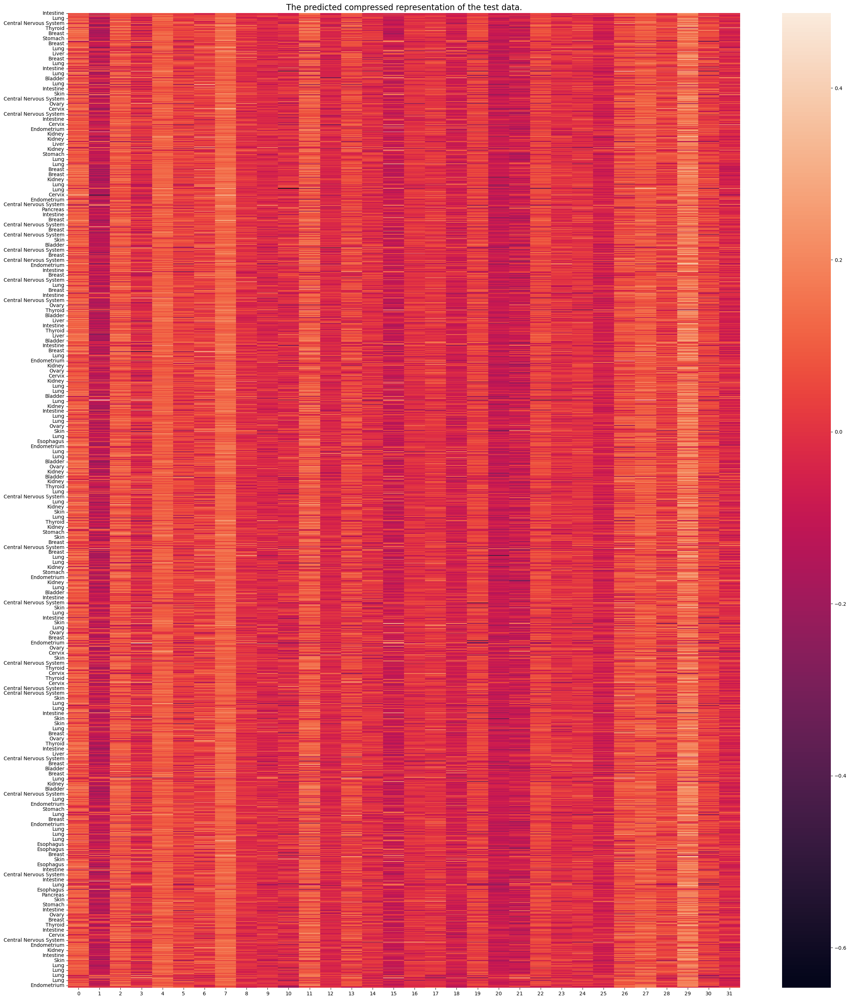

In [114]:
plt.figure(figsize=(30,35))
sns.heatmap(multi_x_predict_df)
plt.title('The predicted compressed representation of the test data.', fontsize=16)
#plt.savefig('final_plots/compressed_test_data.png')
plt.show()

In [115]:
# use the encoder model to use the encoder output on pca to further reduce the dimensionality 
#for highly mutated observation

pca=PCA(n_components=4)
multi_encoder_pca = pca.fit_transform(scale(multi_x_predict))

C:\Users\tes2s\anaconda3\Lib\site-packages\sklearn\preprocessing\_data.py:247: UserWarning:

Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.

C:\Users\tes2s\anaconda3\Lib\site-packages\sklearn\preprocessing\_data.py:266: UserWarning:

Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 



In [116]:
#pca df 
multi_pca_df = pd.DataFrame(multi_encoder_pca, columns=['PCA_component1','PCA_component2','PCA_component3','PCA_component4'])
multi_pca_df['Cancer Type'] = x_test_con_type

#Change the cancer type name in to number label
label_coder = LabelEncoder()
multi_pca_df['Cancer Type'] = label_coder.fit_transform(multi_pca_df['Cancer Type'])

multi_pca_df

,PCA_component1,PCA_component2,PCA_component3,PCA_component4,Cancer Type
0,-0.877151,2.610028,-1.278381,0.760691,6
1,4.048215,3.029724,0.871917,-3.022968,9
2,-1.977694,0.812667,0.164559,0.280149,9
3,-2.886416,-1.416580,0.464071,0.792717,0
4,5.118040,3.293962,-2.120332,1.006736,13
...,...,...,...,...,...
1543,-2.975547,3.003917,2.815048,0.867099,14
1544,-0.600440,3.547302,-1.733507,-0.659573,4
1545,5.308012,3.715421,-0.546587,3.324263,3
1546,0.908642,-0.100053,0.167856,3.714517,9


In [117]:
#Change the cancer type name in to number label

label_coder = LabelEncoder()
cancer_code = label_coder.fit_transform(multi_pca_df['Cancer Type'])

#get the unique cancer types
df_coded_cancer = pd.DataFrame([cancer_code, x_test_con_type]).transpose().drop_duplicates()
df_coded_cancer.index= df_coded_cancer[0]
df_coded_cancer.drop(columns=[0], inplace=True)

#change the df to dict
dict_df_coded_cancer = df_coded_cancer.to_dict()
dict_df_coded_cancer

{1: {6: 'Intestine',
  9: 'Lung',
  0: 'Bladder',
  13: 'Stomach',
  7: 'Kidney',
  1: 'Breast',
  4: 'Endometrium',
  14: 'Thyroid',
  12: 'Skin',
  2: 'Central Nervous System',
  10: 'Ovary',
  3: 'Cervix',
  8: 'Liver',
  5: 'Esophagus',
  11: 'Pancreas'}}

In [118]:
multi_pca_df['Cancer Name'] = multi_pca_df['Cancer Type'].map(dict_df_coded_cancer[1])
multi_pca_df

,PCA_component1,PCA_component2,PCA_component3,PCA_component4,Cancer Type,Cancer Name
0,-0.877151,2.610028,-1.278381,0.760691,6,Intestine
1,4.048215,3.029724,0.871917,-3.022968,9,Lung
2,-1.977694,0.812667,0.164559,0.280149,9,Lung
3,-2.886416,-1.416580,0.464071,0.792717,0,Bladder
4,5.118040,3.293962,-2.120332,1.006736,13,Stomach
...,...,...,...,...,...,...
1543,-2.975547,3.003917,2.815048,0.867099,14,Thyroid
1544,-0.600440,3.547302,-1.733507,-0.659573,4,Endometrium
1545,5.308012,3.715421,-0.546587,3.324263,3,Cervix
1546,0.908642,-0.100053,0.167856,3.714517,9,Lung


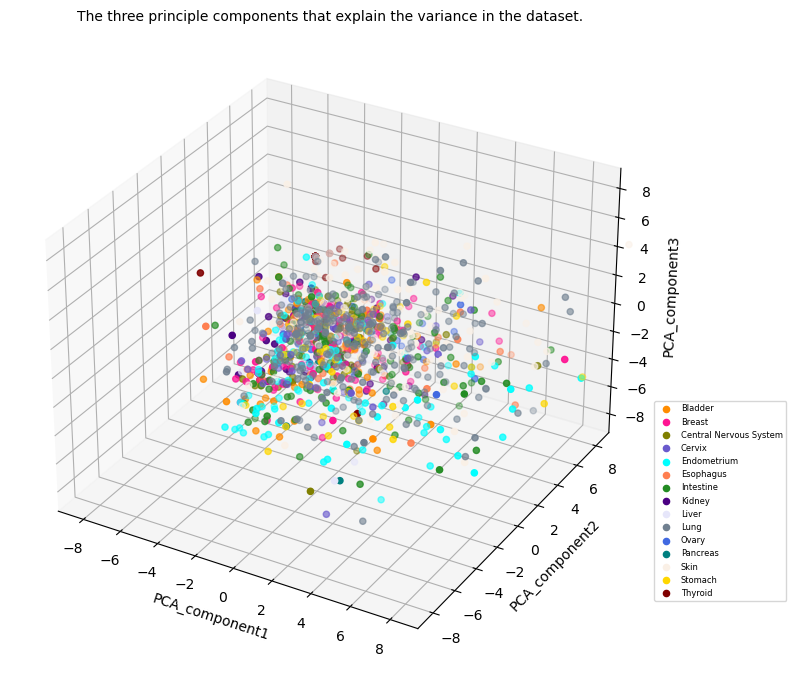

In [119]:
color = {'Ovary':'royalblue', 'Skin':'linen','Intestine':'forestgreen', 'Stomach':'gold', 'Breast':'deeppink', 
       'Endometrium':'cyan', 'Liver':'lavender', 'Bladder':'darkorange', 'Lung':'slategray', 'Central Nervous System':'olive', 
        'Pancreas':'teal', 'Thyroid':'maroon', 'Kidney':'indigo', 'Esophagus':'coral', 'Cervix':'slateblue'}

fig = plt.figure (figsize=(8,10))
ax = fig.add_subplot(projection='3d')

y=multi_pca_df['Cancer Name']

for cancer_name, group in multi_pca_df.groupby('Cancer Name'):
    ax.scatter(group['PCA_component1'],
               group['PCA_component2'],
               group['PCA_component3'], 
               c=color[cancer_name], 
               label=cancer_name)
    
ax.set_xlim([-9, 9])  
ax.set_ylim([-9, 9])  
ax.set_zlim([-9, 9])
ax.set_xlabel('PCA_component1')
ax.set_ylabel('PCA_component2')
ax.set_zlabel('PCA_component3')
ax.legend(loc='lower left', bbox_to_anchor=(1,0.1),fontsize=6)
ax.set_title('The three principle components that explain the variance in the dataset.', fontsize=10)

plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

fig.set_size_inches(11, 8) 
#plt.savefig('final_plots/three_principle_components_multi.png')
plt.show()



In [120]:
#PCA for the encoder output 

#### Plots and dataframes for the dashboard

In [121]:
import pandas as pd
import dash
from dash import Dash, dcc, html, dash_table
import dash_bootstrap_components as dbc
import plotly.express as px
import plotly.graph_objects as go 
from dash.dependencies import Input, Output
import pandas as pd
from plotly.colors import n_colors
from dash_bootstrap_templates import load_figure_template
load_figure_template("darkly")

In [122]:
#no mutation(cells that are mutated less than 5% are considered as not mutated) #to update the dashboard 
cell_less_5_pec = cell_prop_no
tissue_less_5_pec = tissue_prop_no

#Mutated (cells that are mutated more that 5% are considered mutated)
cell_more_5_perc = cell_prop_low + cell_prop_medium + cell_prop_high
tissue_more_5_perc = tissue_prop_low + tissue_prop_medium + tissue_prop_high

#create a general df for(not and mutated samples)
#cell + tissue
radio_item = pd.DataFrame([mutation_list, cell_less_5_pec, cell_more_5_perc, tissue_less_5_pec, tissue_more_5_perc ]).transpose()
radio_item.columns = ['Gene And Mutation Type','% of Cell Line Samples Not Mutated', '% of Cell Line Samples Mutated', '% of Tissue Samples Not Mutated', '% of Tissue Samples Mutated']
radio_item  = radio_item.sort_values(by='% of Tissue Samples Not Mutated')

#cell_line + tissue sample
drop_mutated_item_prop = pd.DataFrame([mutation_list, cell_prop_low, cell_prop_medium, cell_prop_high, tissue_prop_low,tissue_prop_medium,tissue_prop_high]).transpose()

drop_mutated_item_prop.columns = ['Gene And Mutation','>0.05 and <= 15% Cell line', '>15% and <= 65% Cell line', '>65% Cell line','>0.05 and <= 15% Tissue sample', '>15% and <= 65% Tissue sample', '>65% Tissue sample']


In [123]:
#Dict of cancer type dataframes for updating the dashboard graph id  bar_cell+tissue

cell_options = {'Bladder': bladder_cell_prop, 'Breast': breast_cell_prop, 
                'Central Nervous System': c_nervous_s_cell_prop, 'Cervix':cervix_cell_prop,'Endometrium': endometrium_cell_prop,
                'Esophagus': esophagus_cell_prop, 'Intestine': intestine_cell_prop,
               'Kidney':kidney_cell_prop, 'Liver': liver_cell_prop, 
               'Lung':lung_cell_prop, 'Ovary':ovary_cell_prop, 
                'Pancreas': pancreas_cell_prop, 'Skin':skin_cell_prop,
               'Stomach':stomach_cell_prop, 'Thyroid':thyroid_cell_prop}

tissue_options = {'Bladder': bladder_tissue_prop, 'Breast': breast_tissue_prop,
                'Central Nervous System': c_nervous_s_tissue_prop, 'Cervix': cervix_tissue_prop,'Endometrium': endometrium_tissue_prop,
                'Esophagus': esophagus_tissue_prop, 'Intestine': intestine_tissue_prop,
               'Kidney':kidney_tissue_prop, 'Liver': liver_tissue_prop, 
               'Lung':lung_tissue_prop, 'Ovary':ovary_tissue_prop, 
                'Pancreas': pancreas_tissue_prop, 'Skin':skin_tissue_prop,
               'Stomach':stomach_tissue_prop, 'Thyroid':thyroid_tissue_prop}


In [124]:
#proportion distribution plot(cell line)

#density plot #cell line
data= cell_mutated_percent.values
colors=n_colors('rgb(5,200,200)', 'rgb(200,10,10)', 15, colortype='rgb')

fig_cell_violin = go.Figure()

for name, data_line, color in zip(stats_cell_mutated.index, data, colors): # type: ignore
    fig_cell_violin.add_trace(go.Violin(x=data_line, line_color=color, name=name))
        
fig_cell_violin.update_traces(orientation='h', side='positive', width=3, points=False)
fig_cell_violin.update_layout(xaxis_showgrid=False,xaxis_zeroline=False, 
                              title='Distribution of mutation over 5% in cell line based on cancer type.',
                              xaxis = dict(tickmode='array',
                              tickvals=[0,10,20,30,40,50,60,70,80,90,100],range=[0,100],title='Total cell line samples mutation percentage.'))
fig_cell_violin.show() 

In [125]:
#proportion distribution plot (tissue samples)

data= stats_tissue_mutated.values
colors=n_colors('rgb(5,200,200)', 'rgb(200,10,10)', 15, colortype='rgb')

fig_tissue_violin = go.Figure()

for name, data_line, color in zip(stats_tissue_mutated.index, data, colors): # type: ignore
    fig_tissue_violin.add_trace(go.Violin(x=data_line, line_color=color, name=name))
        
fig_tissue_violin.update_traces(orientation='h', side='positive', width=3, points=False)
fig_tissue_violin.update_layout(xaxis_showgrid=False,xaxis_zeroline=False, title='<br>Distribution of mutation over 5% in patient tissue</b><br> samples based on cancer type.',
                               xaxis = dict(tickmode='array',
                      tickvals=[0,10,20,30,40,50,60,70,80,90,100],range=[0,100],title='Total patient samples mutation percentage.'))
fig_tissue_violin.show() 


In [126]:
#percentage density heatmap #cell line
stat = cell_mutated_percent
stat['Cancer type']  = cell_mutated_percent.index

# Melt the df
data_melted = stat.melt(id_vars='Cancer type', var_name='Gene and mutation', value_name='Mutation percentage')

# Create a density plot
fig_cell_perc_sum = px.density_heatmap(data_melted, x='Cancer type', y='Gene and mutation', z= 'Mutation percentage', 
                         histfunc="sum", color_continuous_scale="Viridis")

fig_cell_perc_sum.update_layout(
    title="Pecentage density plot for cell line samples that are mutated more than 5%.",
    yaxis_title="Gene and muatation",
    xaxis_title="Cancer Type")


fig_cell_perc_sum.update_yaxes(tickfont=dict(size=8))
fig_cell_perc_sum.update_xaxes(tickfont=dict(size=8))
fig_cell_perc_sum.show() 

In [127]:
#percentage density heatmap #tissue sample
stat = stats_tissue_mutated
stat['Cancer type']  = stats_tissue_mutated.index

# Melt the df
data_melted = stat.melt(id_vars='Cancer type', var_name='Gene and mutation', value_name='Mutation percentage')

# Create a density plot
fig_tissue_pec_sum = px.density_heatmap(data_melted, x='Cancer type', y='Gene and mutation', z='Mutation percentage', 
                         histfunc="sum", color_continuous_scale="Viridis")

fig_tissue_pec_sum.update_layout(
    title='Pecentage density plot for patient tissue samples that are mutated more than 5%.',
    yaxis_title='Gene and muatation',
    xaxis_title='Cancer Type'
)

fig_tissue_pec_sum.update_yaxes(tickfont=dict(size=8))
fig_tissue_pec_sum.update_xaxes(tickfont=dict(size=8))
fig_tissue_pec_sum.show()

In [128]:
#P_value of the chi square independece test based on cancer types
heat_map = go.Heatmap(
                        z = np.clip(-np.log10(p_value_combo),1,4), 
                        x=df.columns, 
                        y=df.index, 
                        colorscale= 'cividis')

fig_heat = go.Figure(data=[heat_map])
fig_heat.update_xaxes(side='top')

fig_heat.update_layout(title=dict(text= 'Heatmap showing the association between gene mutation and cancer tissue types', y=0.99,
                                  font= dict(size=15)),
                       height=1000,
                       xaxis=dict(tickfont=dict(size=8), title=dict(text='Cancer tissue types', standoff=0.80, font=dict(size=12))),
                       yaxis=dict(title=dict(text='Gene and mutation types', font=dict(size=12)),tickfont=dict(size=8),), 
                       yaxis_nticks=len(df.index))

fig_heat.show()

In [129]:
#heatmap df for the checklist
df1 = df.transpose().reset_index()

In [130]:
#binary encoder prediction figure 
color = {'Ovary':'rgb(255, 0, 0)', 'Skin':'rgb(0, 255, 0)','Intestine':'rgb(0, 0, 255)', 'Stomach':'rgb(255, 255, 0 )', 'Breast':'rgb(255, 0, 255)', 
       'Endometrium':'rgb(0, 255, 255)', 'Liver':'rgb(128, 0, 0)', 'Bladder':'rgb(0, 128, 0)', 'Lung':'rgb(0, 0, 128)', 'Central Nervous System':'rgb(128, 128, 0)', 
        'Pancreas':'rgb(128, 0, 128)', 'Thyroid':'rgb(0, 128, 128)', 'Kidney':'rgb(128, 128, 128)', 'Esophagus':'rgb(192, 192, 192)', 'Cervix':'rgb(255, 165, 0)'}


traces = []
for cancer_name, group in pca_df.groupby('Cancer Name'):
    trace = go.Scatter3d(
        x=group['PCA_component1'],
        y=group['PCA_component2'],
        z=group['PCA_component3'],
        mode='markers',
        marker=dict(
            size=4,
            color=color[cancer_name],
            opacity=0.8,
            symbol='circle'
        ),
        name=cancer_name
    )
    traces.append(trace)

# Layout
layout = go.Layout(
    scene=dict(
        xaxis=dict(title='PCA_component1'),
        yaxis=dict(title='PCA_component2'),
        zaxis=dict(title='PCA_component3')
    ),
    legend=dict(x=0.05, y=0.95),
    title='3D Satter Plot for the Multi-Class Encoder Prediction Output.'
   
   
   
)

# Plot
fig1 = go.Figure(data=traces, layout=layout)
fig1.show()

In [131]:
#multi-calss encoder prediction
traces = []
for cancer_name, group in multi_pca_df.groupby('Cancer Name'):
    trace = go.Scatter3d(
        x=group['PCA_component1'],
        y=group['PCA_component2'],
        z=group['PCA_component3'],
        mode='markers',
        marker=dict(
            size=4,
            color=color[cancer_name],
            opacity=0.8,
            symbol='circle'
        ),
        name=cancer_name
    )
    traces.append(trace)

# Layout
layout = go.Layout(
    scene=dict(
        xaxis=dict(title='PCA_component1'),
        yaxis=dict(title='PCA_component2'),
        zaxis=dict(title='PCA_component3')
    ),
    legend=dict(x=0.05, y=0.95),
    title='3D Satter Plot for the Binary Encoder Prediction Output.'
   
   
   
)

# Plot
fig2 = go.Figure(data=traces, layout=layout)
fig2.show()

In [132]:
#### Dashboard for the project

In [133]:
app =  dash.Dash(__name__,external_stylesheets=[dbc.themes.DARKLY])

#load figure template
load_figure_template("darkly")



In [134]:
#header
topbar = html.Div([
            html.Div([
                html.H1('Characterisation of cancer cell-lines and patient tissue samples using machine learning.',style={'fontSize':'25px'}),
                html.H2('Bachelor Project-Applied Data Science.',style={'fontSize':'25px'}),
                html.H2('Noroff Universty Collage, May 2024.',style={'fontSize':'20px', })
                ],style={'backgroundColor':'DarkSlateGrey', 'padding': '4px', 'margin':'20px', 'border-radius': '10px 30px','textAlign':'center'}
                ),
        dbc.Nav([
                dbc.NavLink('Exploration', href='/', active='exact', style={'fontSize': '17px', 'color':'yellow'}),
                dbc.NavLink('Chi-square statistic', href='/page-1', active= 'exact', style={'fontSize': '17px', 'color':'yellow'}),
                dbc.NavLink('Binary encoder prediction', href='/page-2', active='exact', style={'fontSize': '17px', 'color':'yellow'}),
                dbc.NavLink('Multi-class encoder prediction', href='/page-3', active='exact', style={'fontSize': '17px', 'color':'yellow'}),
                ], style={'padding': '4px'}),
])  

content = html.Div(id='page-content', children=[])

app.layout = html.Div([dcc.Location(id="url"), 
                       topbar,
                       content,
                       ],style = {'margin':'20px', 'color':'lightgray'})


In [135]:
#page layout callback
@app.callback(
     Output(component_id='page-content', component_property='children'),
     [Input(component_id="url",component_property= "pathname") ]  
)

def render_page_content(pathname):
    
    if pathname == '/':
        return [
            html.Div([
                
                dbc.Row([
                   dbc.Col(
                    html.Label(('Wild-type refer to the samples that were tested and found to have gene muation that was less than 5%'), style={'font-weight':'bold'}))
                   ]),
            
            dbc.Row([
                   dbc.Col(html.Div(                        
                     dcc.RadioItems(id='x_status_not_mutated',
                                  options=[{'label':'Wild-type cell lines', 'value': '% of Cell Line Samples Not Mutated' },
                                           {'label': 'Wild-type tissue samples', 'value': '% of Tissue Samples Not Mutated'}],
                                  value='% of Cell Line Samples Not Mutated',                          
                                  )), width=6, md=4),                   
            ]),
            
            html.Div([
                html.Br(),
                dbc.Row(dcc.Graph(id='graph1', config={'displayModeBar': False},style={'padding': "5px"})),   
                ]),
                
                
                dbc.Row([
                    dbc.Col(
                    html.Label(('Mutated refer to the samples that were tested and found to have gene muation that was more than 5%'), style={'font-weight':'bold'})),
                        ])  
                ]), 
            
            dbc.Row([
                dbc.Col(html.Div(                        
                    dcc.RadioItems(id='x_status',
                                   options=[{'label':'Mutated cell lines', 'value': '% of Cell Line Samples Mutated' },
                                            {'label': 'Mutated tissue samples', 'value': '% of Tissue Samples Mutated'}],
                                   value='% of Cell Line Samples Mutated',                            
                                    )), width=6, md=4),
                dbc.Col(html.Div(
                    dcc.RadioItems(id= 'y_Mutation_Type',
                                 options=[{'label': 'Mutation', 'value':'Gene And Mutation Type'}],
                                 value = 'Gene And Mutation Type',
                                 labelStyle={'display':'inline-block'}
                                 )), width=6, md=4), 
                    ]),
            
            html.Div([
                html.Br(),
                dbc.Row(dcc.Graph(id='graph2', config={'displayModeBar': False}),),   
                     ]),
            


            
            dbc.Row([
                    html.Label('Compare cell line and tissue samples that are mutated above 5%.')
                    ]),
               
                
                dbc.Row([
                    
                    dbc.Col([    
                        dcc.Dropdown(id='dropdown1',
                                    options=[{'label':gene, 'value':gene} for gene in aggregated_df['Gene and Mutation Type']],
                                    value = 'AKAP9_missense',
                                    placeholder='Select Gene 1',
                                    style={'color':'grey', 'padding':'1px'},
                                    )
                            ], width=2, style={'padding-right': '10px'}),
                            
                dbc.Col([
                        dcc.Dropdown(id='dropdown2',
                                    options=[{'label':gene, 'value':gene} for gene in aggregated_df['Gene and Mutation Type']],
                                    value = 'AKAP9_missense',
                                    placeholder='Select Gene 2',
                                    style={'color':'grey', 'padding':'1px'},
                                    ), 
                    
                            ], width=2, style={'padding-left': '10px'}),
                
                        ]),
            
            dbc.Row([dcc.Graph(id='graph3', figure={},config={'displayModeBar': False}, style={'padding':'5px'} )]),
            
                
            dbc.Row([html.Label('Further categorisation of selected mutated genes above into three levels: between 0-14%, 15-64% and above 65% '),
                    
                     dcc.Graph(id='graph4', figure={},config={'displayModeBar': False}, style={'padding':'5px'} ) 
                    ]),
            
            
            dbc.Row([html.Label('The following graphs show the distrbution of both cell line and tissue samples that have been found to have more than 5% gene muation in their sample. ')
                   ]),
            
            dbc.Row([                
                dbc.Col([
                     dcc.Graph(id='graph6', figure=fig_cell_violin, config={'displayModeBar': False}, style={'padding':'5px'}),
                        ],width=6),
                dbc.Col([
                     dcc.Graph(id='graph7', figure=fig_cell_perc_sum, config={'displayModeBar': False}, style={'padding':'5px'}),
                    
                ],width=6)]),
                
                dbc.Row([
                
                dbc.Col([
                     dcc.Graph(id='graph8', figure=fig_tissue_violin, config={'displayModeBar': False}, style={'padding':'5px'}),
                         ],width=6), 
                dbc.Col([
                
                     dcc.Graph(id='graph9', figure=fig_tissue_pec_sum, config={'displayModeBar': False}, style={'padding':'5px'}),
                       ], width=6),
                
                 ]),
            
            
            html.Div([
                dbc.Row([html.Label('Comparsion of gene mutation based on cancer type'),
                         
                    dbc.Col([html.Label('Cell line cancer type:'),
                            dcc.Dropdown(
                                       id='cell_cancer_type',                                     
                                       options=[{'label': df_name, 'value': df_name}for df_name in cell_options.keys()],
                                       value = list(cell_options.keys())[0],
                                       searchable= True,
                                       clearable = False,
                                       style={'color':'grey', 'padding': '1px'}
                                       )], width=4),
                         
                         
                    dbc.Col([html.Label('Tissue sample cancer type: '),
                                       dcc.Dropdown(
                                       id='in_vitro_cancer_type',
                                       options=[{'label':df_name1, 'value': df_name1} for df_name1 in tissue_options.keys()],
                                       value = list(tissue_options.keys())[0],
                                       searchable=True,
                                       clearable=False,
                                       style={'color':'grey','padding':'1px'}
                                          ),                                    
                                      ],width=4),
                            
                               
                    dbc.Col([html.Label('Gene and mutation type:'),
                                dcc.Dropdown(
                                    id='gene_and_mutation',
                                    value = 'ARID1A_frameshift',
                                    options=[{'label':point, 'value':point} for point in aggregated_df['Gene and Mutation Type'] ],
                                    searchable=True,
                                    style={'color':'grey', 'padding':'1px'}    
                                        )], width=4),
                 ])
                ]),
            
         html.Div([
             dbc.Row([
                 dcc.Graph(id='bar_cell+tissue', figure={}, config={'displayModeBar': False},style={'color':'grey', 'padding': '1px'})]),
                 dbc.Row([html.Div(id='gene_df') ]),
                 dbc.Row([html.Div(id='gene_df1') ])
             
             
                 
             ]),         
                 
             
                    
]
    
    elif pathname == "/page-1":
        return [
            
            html.Div([
                        html.Label('The heatmap identifies the relationship between the gene and muation type and the cancer type.\n The darker the heatmap cell is the greater the relationship is between the row and the column.'),
                        dcc.Graph(id='chi_graph', figure=fig_heat, config={'displayModeBar': False})
                    
                ]),  
            ]
    
    elif pathname == "/page-2":
        return [
                html.Label('Binary encoder prediction for the test data',),
            
                dcc.Graph(id='scatter1',
                         figure=fig1)
                ]
    elif pathname == "/page-3":
        return [
                html.Label('Multi class encoder prediction for the test data',
                       ),
                dcc.Graph(id='scatter2',
                         figure=fig2)
                ]

In [136]:
#update pages 
#RadioItems callback mutated
@app.callback(
    Output(component_id='graph1', component_property='figure'),
    [Input(component_id='x_status_not_mutated', component_property='value'),
     Input(component_id='y_Mutation_Type', component_property='value')
    ]
)

def update_graph1(x_status, y_Mutation_Type):
    
    df_ = radio_item
    df_ = df_.sort_values(by=f'{x_status}',ascending=True)
    fig=px.bar(
        data_frame=df_,
        x=x_status,
        y=y_Mutation_Type,
        orientation='h',
        height=1000,
        title=f'Showing {x_status} by {y_Mutation_Type}'         
    )
    fig.update_traces(marker_color='darkgreen')
    
    fig.update_layout(xaxis_range=[0,100])

    return fig

#RadioItems callback- not mutated
@app.callback(
    Output(component_id='graph2', component_property='figure'),
    [Input(component_id='x_status', component_property='value'),
     Input(component_id='y_Mutation_Type', component_property='value')
    ]
)

def update_graph2(x_status, y_Mutation_Type):
    
    df_ = radio_item
    df_ = df_.sort_values(by=f'{x_status}', ascending=True)
    fig=px.bar(
        data_frame=df_,
        x=x_status,
        y=y_Mutation_Type,
        orientation='h',
        height=1000,
        title=f'Showing {x_status} by {y_Mutation_Type}'
    )
    fig.update_traces(marker_color='firebrick')
    fig.update_layout(xaxis_range=[0,100])
    
    return fig


In [137]:
# Compare mutations 

@app.callback(
    Output(component_id='graph3', component_property='figure'),
    [Input(component_id='dropdown1', component_property='value'),
     Input(component_id='dropdown2', component_property='value')
    ]
)

def update_graph3(gene1, gene2):
    
    
    if gene1 is None or gene2 is None:
        return {'data':[], 'layout':{}}
    
    #filter
    
    df_filtered = aggregated_df[(aggregated_df['Gene and Mutation Type']==gene1)|(aggregated_df['Gene and Mutation Type']==gene2)]
    
    
    cell_line_trace = go.Bar(x=df_filtered['Gene and Mutation Type'],
                             y=df_filtered['Proportion of Cell Line Samples with Mutation >5%'],
                             name='Celll Line'
                            
                            )
    tissue_trace = go.Bar(x=df_filtered['Gene and Mutation Type'],
                          y=df_filtered['Proportion of Patient Tissue Samples with Mutation >5%'],
                          marker_color = 'orange',
                          name='Tissue Sample'
                            )
    
    fig = go.Figure(data=[cell_line_trace, tissue_trace])
    
 
    fig.update_layout(barmode='group',
                      title='Comparison of cell line and tissue samples that are mutated above 5%.', 
                      yaxis_title = 'Total sample %',
                      legend_title= 'Sample type',
                      yaxis = dict(tickmode='array',
                      tickvals=[0,10,20,30,40,50,60,70,80,90,100],range=[0,100]))
    
    return fig


In [138]:
@app.callback(
    Output(component_id='graph4', component_property='figure'),
    [Input(component_id='dropdown1', component_property='value'),
     Input(component_id='dropdown2', component_property='value')
    ]
)

def update_graph4(gene4, gene3):
    
    
    
    #filter
    
    df_filtered1 = drop_mutated_item_prop[(drop_mutated_item_prop['Gene And Mutation']==gene3)|(drop_mutated_item_prop['Gene And Mutation']==gene4)]
    
    
    cell_line_trace_ = go.Bar(x=df_filtered1['Gene And Mutation'],
                             y=df_filtered1['>0.05 and <= 15% Cell line'],
                             name='Celll Line: >0.05 and <= 15%',
                             textposition='auto',
                             marker_color = 'lightgray'
                            )
    cell_line_trace_1 = go.Bar(x=df_filtered1['Gene And Mutation'],
                               y=df_filtered1['>15% and <= 65% Cell line'],
                               name='Celll Line: >15% and <= 65%',
                               marker_color = 'springgreen',
                               textposition='auto'
                             
                            )
    cell_line_trace_2 = go.Bar(x=df_filtered1['Gene And Mutation'],
                               y=df_filtered1['>65% Cell line'],
                               name='Celll Line: >65% ',
                               textposition='auto',
                               marker_color = 'darkred'
                             
                            )
    
    
    
    tissue_trace_ = go.Bar(x=df_filtered1['Gene And Mutation'],
                           y=df_filtered1['>0.05 and <= 15% Tissue sample'],
                          name='Tissue Sample: >0.05 and <= 15%',
                           marker_color = 'lightblue',
                           textposition='auto'
                            )
    
    tissue_line_trace_1 = go.Bar(x=df_filtered1['Gene And Mutation'],
                                 y=df_filtered1['>15% and <= 65% Tissue sample'],
                                 name='Tissue Sample: >15% and <= 65%',
                                  marker_color = 'yellow',
                                 textposition='auto'
                             
                            )
    tissue_line_trace_2 = go.Bar(x=df_filtered1['Gene And Mutation'],
                               y=df_filtered1['>65% Tissue sample'],
                               name='Tissue Sample: >65% ',
                               textposition='auto',
                               marker_color = 'orange'
                             
                            )
    
  
    
    fig = go.Figure(data=[cell_line_trace_, cell_line_trace_1, cell_line_trace_2, tissue_trace_, tissue_line_trace_1, tissue_line_trace_2])
    
    
 
    fig.update_layout(barmode='group',
                      title='Further comparison of the selected genes and mutations', 
                      yaxis_title = 'Total sample %',
                      legend_title= 'Sample type',
                      yaxis=dict(
                    tickmode='array',
                    tickvals=list(range(0, 101, 10)),
                        range=[0, 100]))
    
    return fig
    

In [139]:
#updates the graph for the gene mutation proportion by cancer type

@app.callback(
     Output('bar_cell+tissue', 'figure'),
    
     Input('cell_cancer_type', 'value'),
     Input('in_vitro_cancer_type', 'value'),
     Input('gene_and_mutation', 'value'),
#     Input('column-dropdown-tissue', 'value'),
       
 )

def update_cancer_type_chart(df1, df2,col1):
    df1 = cell_options[df1]
    df2 = tissue_options[df2]
    fig = go.Figure()
    fig.add_trace(go.Bar(x=df1[col1].index, y=df1[col1],name='cell line sample'))
    fig.add_trace(go.Bar(x=df2[col1].index, y=df2[col1], marker_color='orange', name='Patient tissue sample'))
    fig.update_layout(title='Comparison of gene mutations by cancer type.',
                      xaxis_title= f'Mutation level for {col1}',
                      yaxis_title = 'Observed mutation persentage',
                      legend_title= 'Sample type',
                      yaxis=dict(
                      tickmode='array',
                      tickvals=list(range(0, 101, 10)),
                        range=[0, 100]
                      ))
    return fig


In [140]:
# update the value of the mutation by cancer type

@app.callback(
    Output(component_id='gene_df', component_property='children'),
    [Input(component_id='cell_cancer_type', component_property='value'),
    Input(component_id='gene_and_mutation', component_property='value')]
    )


def generate_dataframe(select_type,select_gene):
    
    if select_type in cell_options:
        df = cell_options[select_type]        
        select = df[select_gene].to_dict()
        return html.Div([html.Label(f'The cell line mutation percentage for {select_gene} is:'),
                        html.P(str(select))])
    else:
        return html.Div('No data available')
    
@app.callback(
    Output(component_id='gene_df1', component_property='children'),
    [Input(component_id='in_vitro_cancer_type', component_property='value'),
    Input(component_id='gene_and_mutation', component_property='value')]
    )


def generate_dataframe(select_type1,select_gene1):
    
    if select_type1 in tissue_options:
        df = tissue_options[select_type1]        
        select1 = df[select_gene1].to_dict()
        return html.Div([html.Label(f'The patient tissue sample mutation percentage for {select_gene1} is:'),
                        html.P(str(select1))])
    else:
        return html.Div('No data available')
    


In [141]:
if __name__ == "__main__":
    app.run(debug=False, jupyter_mode='tab')

Dash app running on http://127.0.0.1:8050/


<IPython.core.display.Javascript object>